# Human islets - Beta cell heterogeneity

In [1]:
import scanpy as sc
import matplotlib.pyplot as pl
import numpy as np
import pandas as pd
import seaborn as sns
import xlsxwriter
import gseapy as gp
sc.settings.verbosity = 2
sc.logging.print_header()

scanpy==1.6.0 anndata==0.7.8 umap==0.4.1 numpy==1.21.2 scipy==1.5.4 pandas==1.3.5 scikit-learn==0.22 statsmodels==0.13.2 python-igraph==0.8.0 louvain==0.7.0 leidenalg==0.7.0


In [ ]:
sc.set_figure_params(frameon=False, dpi_save=300, color_map='Reds')

## Manifold beta cells

In [3]:
adata_endo = sc.read('../data/human_processed.h5ad')

In [ ]:
# remove raw counts to decrease memory
del adata_endo.raw

In [ ]:
adata_endo = adata_endo[:, ~adata_endo.var.feature_is_filtered].copy()

In [154]:
adata_beta = adata_endo[adata_endo.obs.louvain_anno_broad.isin(['beta'])].copy()

In [155]:
sc.pp.filter_genes(adata_beta, min_cells=10)

filtered out 871 genes that are detected in less than 10 cells


In [156]:
sc.pp.highly_variable_genes(adata_beta, n_top_genes=2000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [157]:
sc.pp.pca(adata_beta)
sc.pp.neighbors(adata_beta, n_pcs=25)
sc.tl.umap(adata_beta)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:11)
computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


In [167]:
sc.tl.louvain(adata_beta, resolution=0.6)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


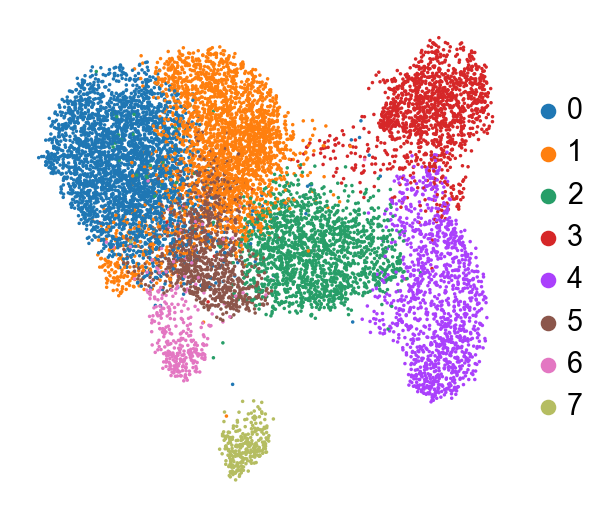

In [168]:
sc.pl.umap(adata_beta, color='louvain', title='')

In [170]:
map_names = {}
for c in adata_beta.obs['louvain'].cat.categories:
    if c in ['0', '1', '5']:
        map_names[c] = 'mature'
    elif c in ['2']:
        map_names[c] = 'immature'
    elif c in ['3']:
        map_names[c] = 'stress I'
    elif c in ['4']:
        map_names[c] = 'stress II'
    elif c in ['6']:
        map_names[c] = 'MHC/autoantigen'
    elif c in ['7']:
        map_names[c] = 'mtDNA deficient'        

adata_beta.obs['louvain_anno_fine'] = adata_beta.obs['louvain']
adata_beta.obs['louvain_anno_fine'] = adata_beta.obs['louvain_anno_fine'].map(map_names).astype('category')

In [171]:
adata_beta.uns['louvain_anno_fine_colors']=[
    '#fdb462',
    '#80b1d3',
    '#b3de69',
    '#bebada',
    '#fb8072',
    '#8dd3c7'
]

In [172]:
adata_beta.obs['louvain_anno_fine'] = adata_beta.obs['louvain_anno_fine'].cat.reorder_categories(
    ['mature', 'immature', 'stress I', 'stress II', 'MHC/autoantigen', 'mtDNA deficient'])

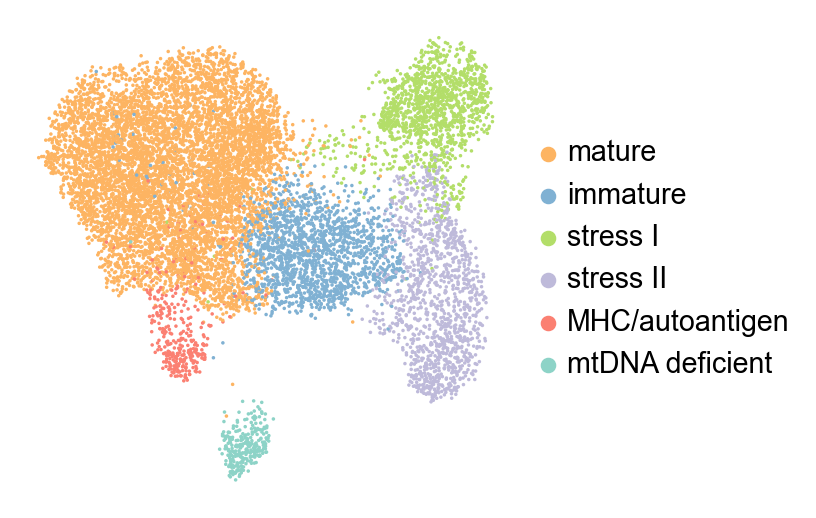

In [173]:
sc.pl.umap(adata_beta, color='louvain_anno_fine', title='')

### save adata

In [174]:
adata_beta.write('./data/adata_human_beta.h5ad')

## QC metrics

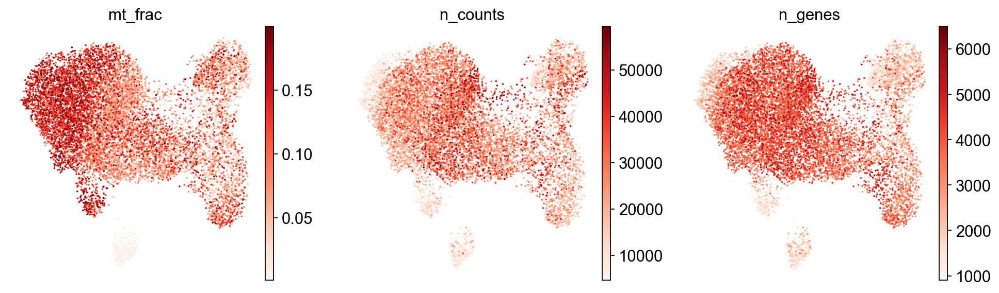

In [10]:
sc.pl.umap(adata_beta, color=['mt_frac', 'n_counts', 'n_genes'], color_map='Reds')

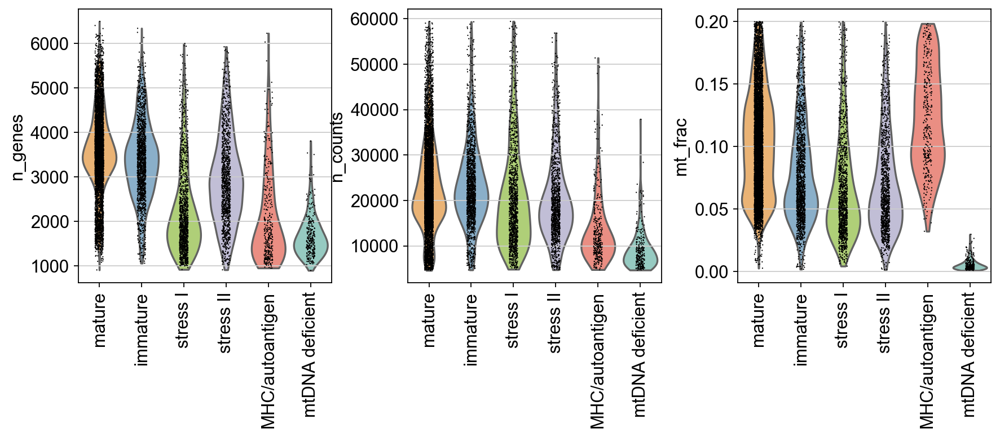

In [438]:
sc.pl.violin(adata_beta, groupby='louvain_anno_fine', keys=['n_genes', 'n_counts', 'mt_frac'], rotation=90)

## Donor composition

In [6]:
adata_beta.obs['louvain_anno_fine'].value_counts()

mature             6999
immature           1711
stress I           1331
stress II          1259
MHC/autoantigen     349
mtDNA deficient     274
Name: louvain_anno_fine, dtype: int64

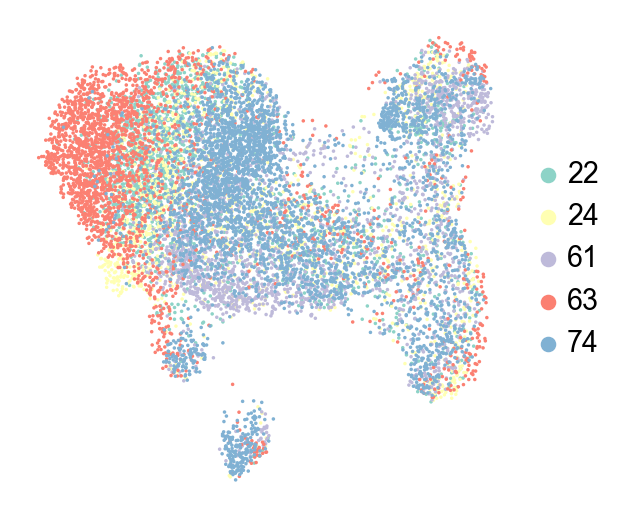

In [9]:
sc.pl.umap(adata_beta,color=['donor'],title='',save='beta_donors.pdf')

In [10]:
sc.tl.embedding_density(adata_beta,groupby='donor',basis='umap')

computing density on 'umap'


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1156: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_over('black')
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1157: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_under('lightgray')
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/scatterplots.py:400: MatplotlibDeprecationWarning: Passing paramete

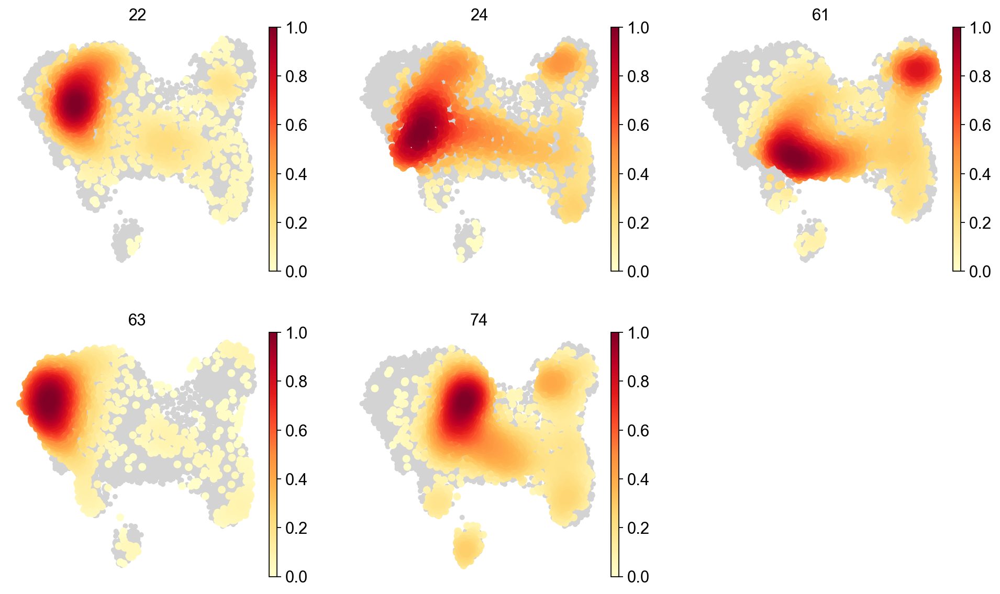

In [13]:
sc.pl.embedding_density(adata_beta,basis='umap',key='umap_density_donor',ncols=3)

findfont: Font family ['Helvetica Light'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica Light'] not found. Falling back to DejaVu Sans.


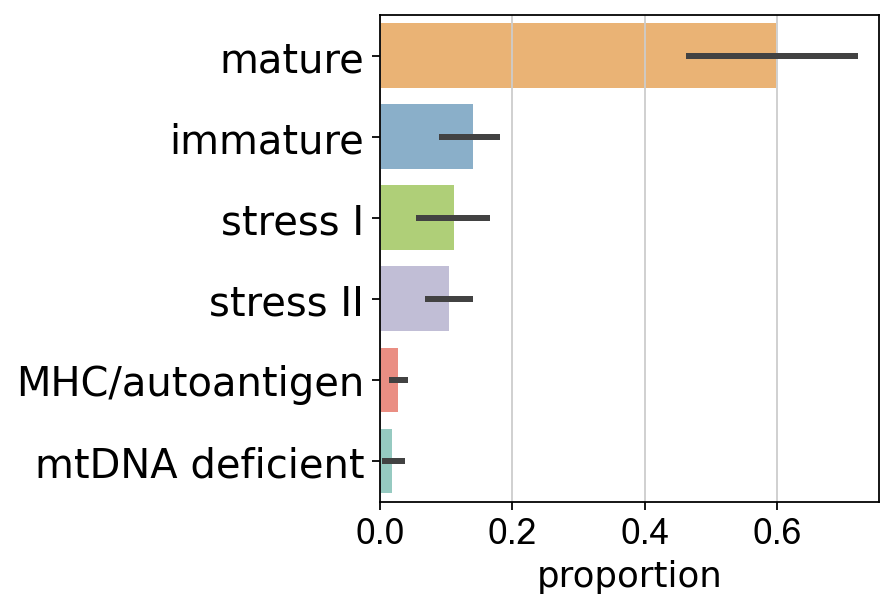

In [21]:
df=adata_beta.obs[['louvain_anno_fine','donor']]

pl.subplots()
x='louvain_anno_fine'
hue='donor'
y='proportion'
prop_df = (df[x]
            .groupby(df[hue])
            .value_counts(normalize=True)
            .rename(y)
            .reset_index())

sns.barplot(x=y, y=x, data=prop_df, palette=adata_beta.uns['louvain_anno_fine_colors'], orient='h')
pl.xticks(rotation=0,fontsize=16)
pl.yticks(rotation=0,fontsize=18,fontname='Helvetica Light')
pl.ylabel('')
pl.xlabel('proportion',fontsize=16,fontname='Helvetica Light')
pl.show()

## Idenitity and functional marker expression

### Identity and maturity genes

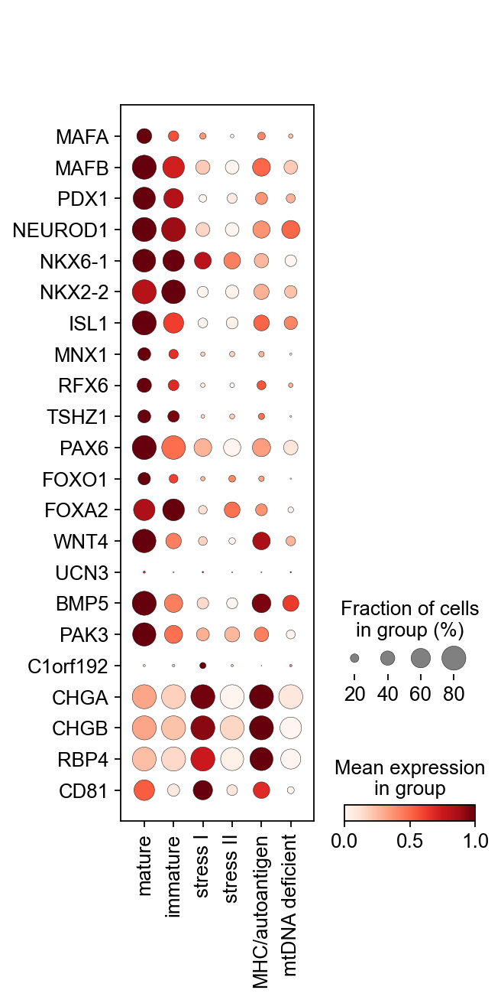

In [22]:
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine',
              var_names=['MAFA', 'MAFB', 'PDX1', 'NEUROD1', 'NKX6-1', 'NKX2-2', 'ISL1', 'MNX1', 'RFX6', 
                         'TSHZ1', 'PAX6', 'FOXO1', 'FOXA2', 'WNT4', 'UCN3', 'BMP5', 'PAK3', 'C1orf192',
                         'CHGA', 'CHGB', 'RBP4', 'CD81'],
              standard_scale='var', dot_max=0.8, swap_axes=True)

### Insulin synthesis

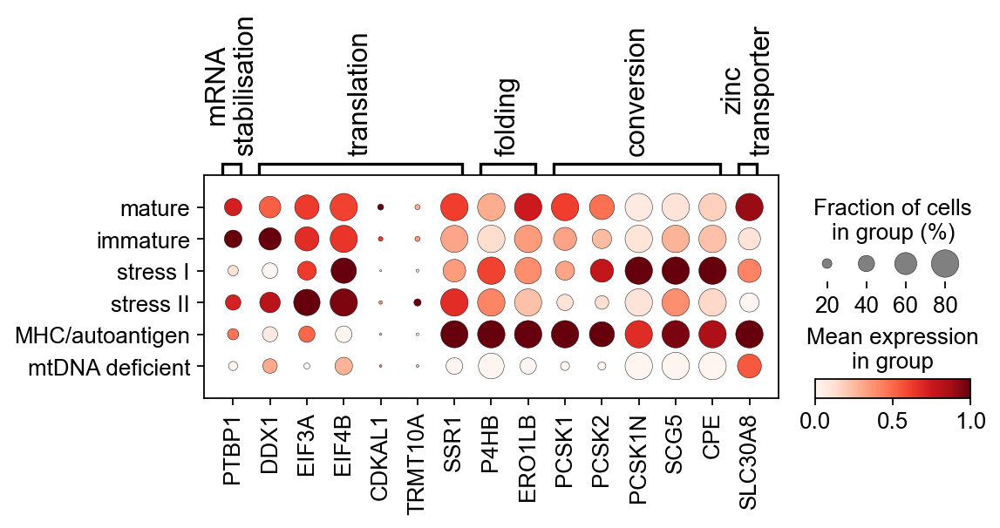

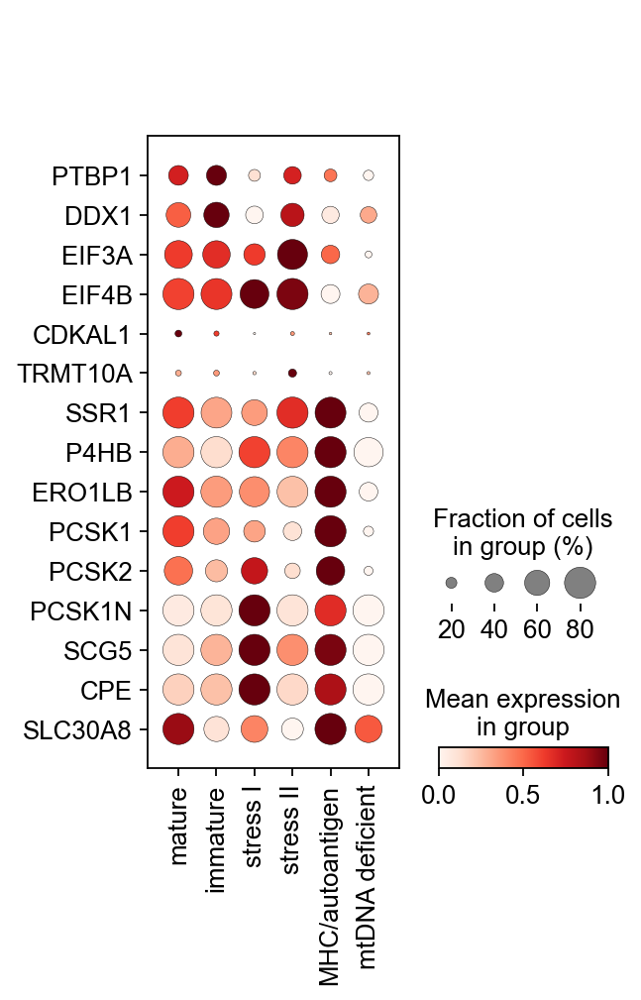

In [23]:
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine',
              var_names=['PTBP1', 'DDX1', 'EIF3A', 'EIF4B', 'CDKAL1', 'TRMT10A', 'SSR1', 'P4HB', 'ERO1LB', 'PCSK1','PCSK2','PCSK1N','SCG5','CPE', 'SLC30A8'],
              var_group_labels=['mRNA\nstabilisation', 'translation', 'folding','conversion', 'zinc\ntransporter'],
              var_group_positions=[(0,0), (1,6), (7,8), (9,13), (14,14)],
              standard_scale='var', dot_max=0.8)

sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine',
              var_names=['PTBP1', 'DDX1', 'EIF3A', 'EIF4B', 'CDKAL1', 'TRMT10A', 'SSR1', 'P4HB', 'ERO1LB', 'PCSK1','PCSK2','PCSK1N','SCG5','CPE', 'SLC30A8'],
              standard_scale='var', dot_max=0.8, swap_axes=True)

### Insulin secretion

In [169]:
insulin_sec = {'nutrient\ntransport/\nprocessing': ['SLC2A1', 'SLC2A2', 'SLC2A3', 'GCK'], 
               'secretory\ngranules': ['SYT7', 'SYT9', 'RAB27A', 'RAB3A', 'SNAP25', 'STX1A', 'STXBP1', 'CDC42', 'UNC13A', 'VAMP2', 'AP3B1']}

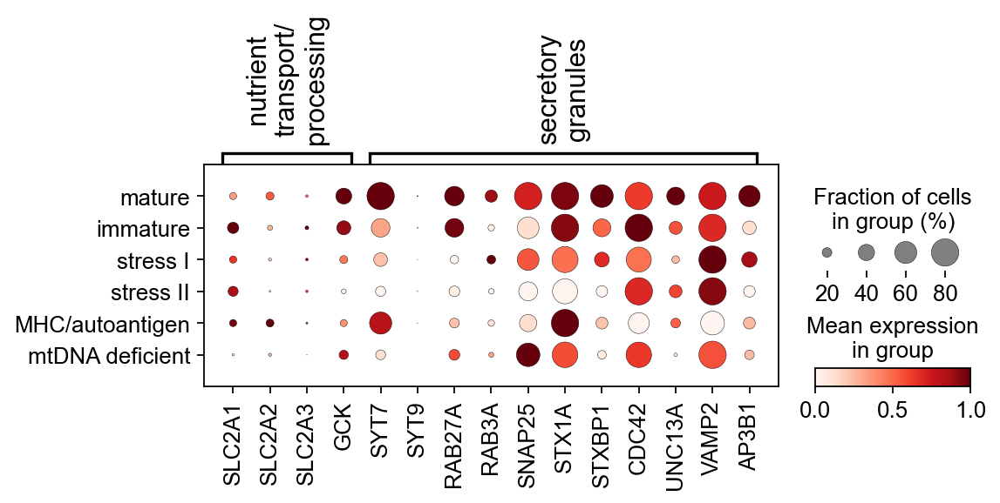

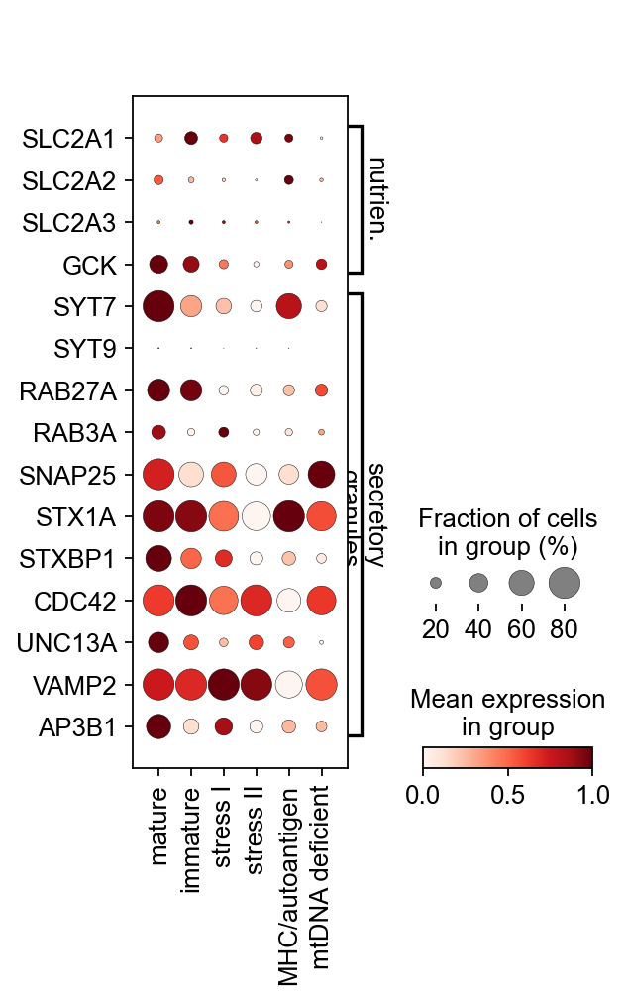

In [170]:
sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = insulin_sec,
              standard_scale='var', dot_max=0.8)
sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = insulin_sec,
              standard_scale='var', dot_max=0.8, swap_axes=True)


### Ion channels

In [171]:
ion_channel = {'K+ channel': ['KCNJ11', 'KCNJ8', 'KCNJ6', 'ABCC8', 'ABCC9'],
               'Ca2+ sensing/\nchannels':['CASR', 'CACNA1A', 'CACNA1C', 'CACNA1D'],
               'Na+ channels':['SCN1B', 'SCN3A', 'SCN3B', 'SCN9A']}

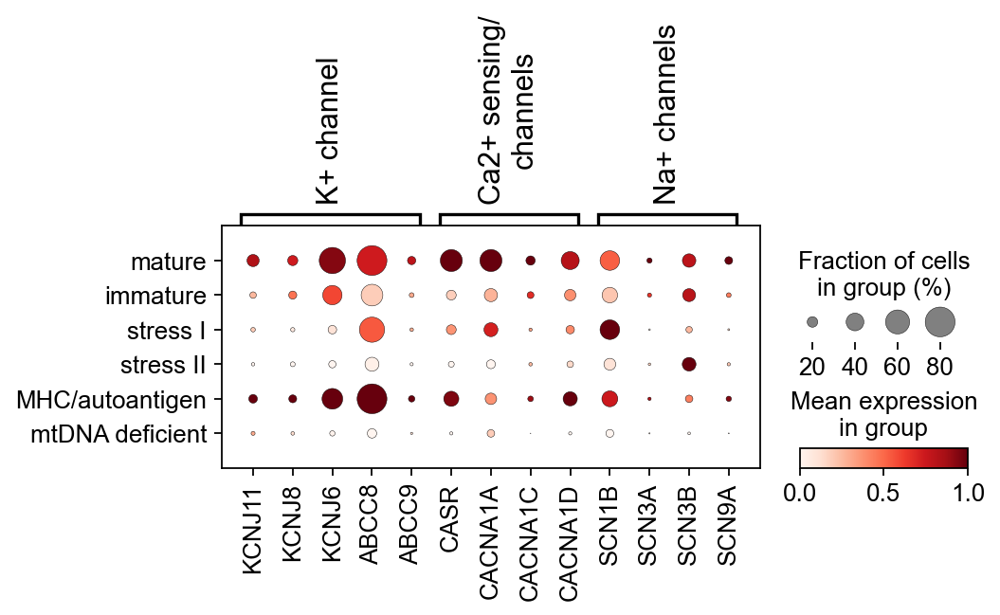

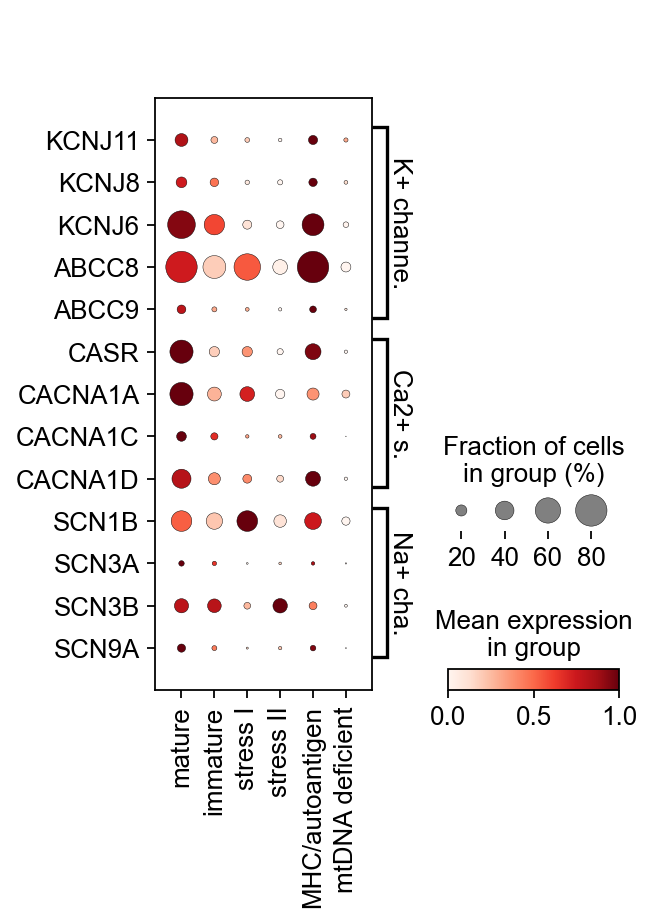

In [172]:
sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = ion_channel,
              standard_scale='var', dot_max=0.8)
sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = ion_channel,
              standard_scale='var', dot_max=0.8, swap_axes=True)


In [187]:
adata_beta_2 = adata_beta.copy()
sc.pp.filter_genes(adata_beta_2, min_cells=200)

filtered out 5632 genes that are detected in less than 200 cells


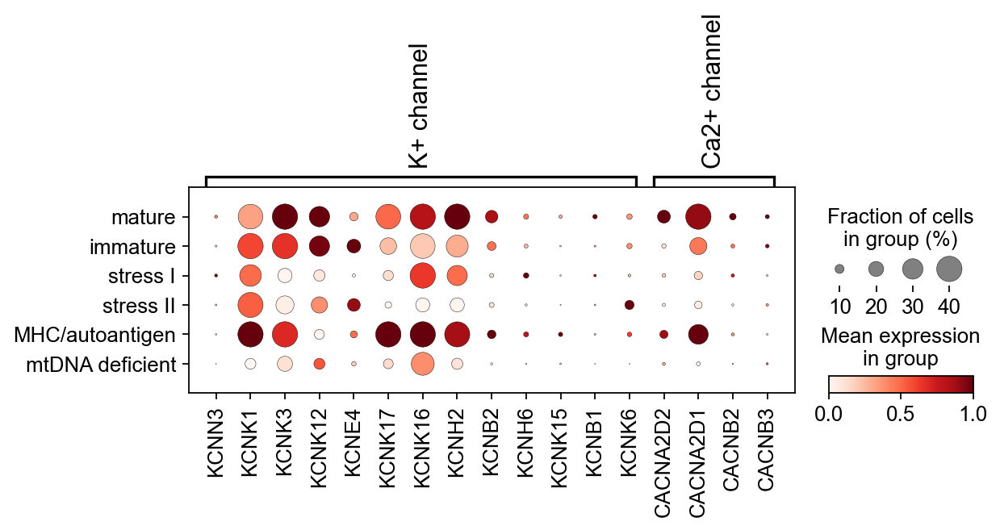

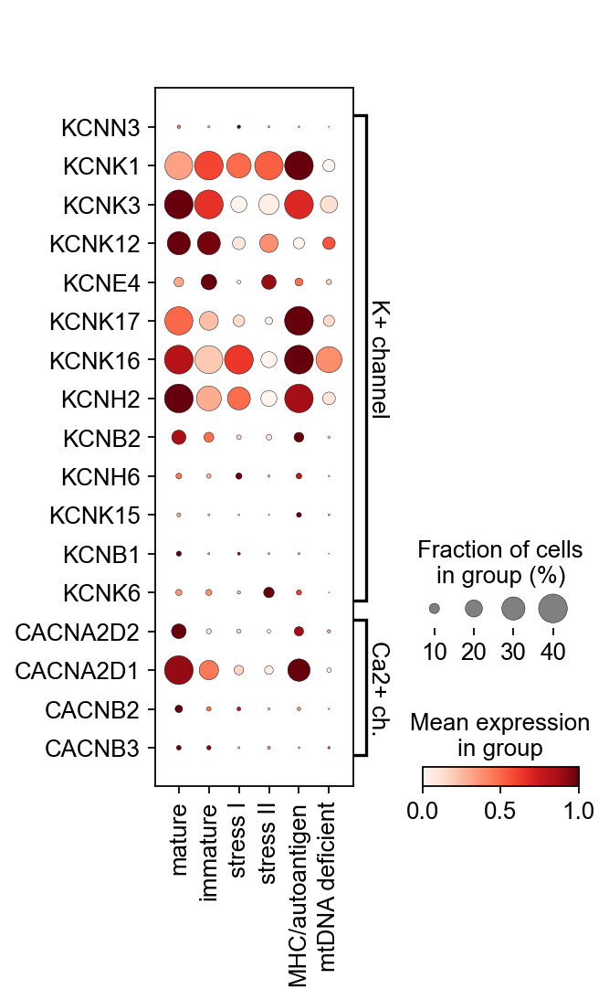

In [189]:
ion_channels = {'K+ channel': [gene for gene in adata_beta_2.var_names if (gene.startswith('KCNB')) | (gene.startswith('KCNK')) | (gene.startswith('KCNH')) | (gene.startswith('KCNN')) | (gene.startswith('KCNE'))],
                'Ca2+ channel': [gene for gene in adata_beta_2.var_names if gene.startswith('CACNA2') | (gene.startswith('CACNB'))]
                                                                            }

sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = ion_channels,
              standard_scale='var', dot_max=0.4)
sc.pl.dotplot(adata_beta,groupby='louvain_anno_fine',
              var_names = ion_channels,
              standard_scale='var', dot_max=0.4, swap_axes=True)

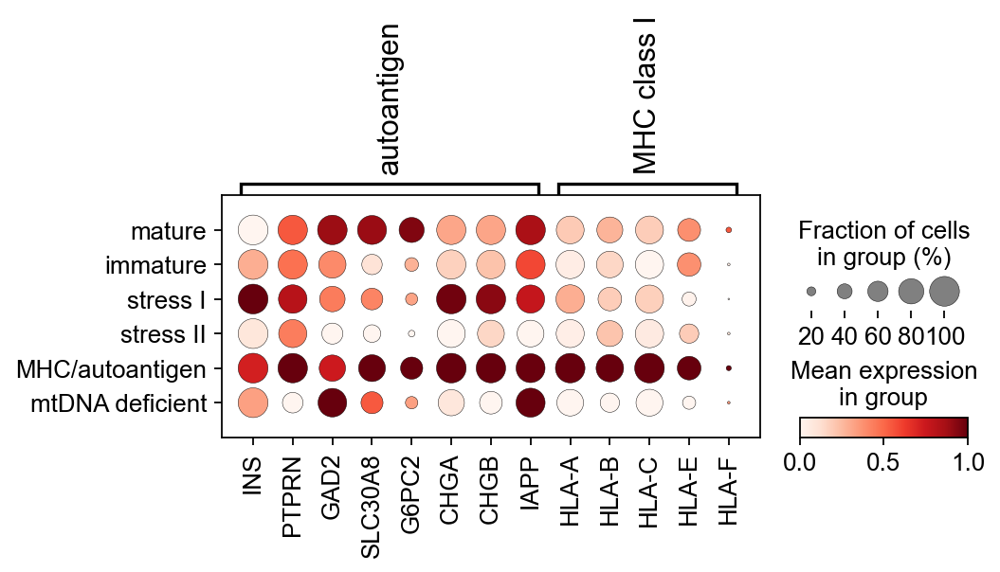

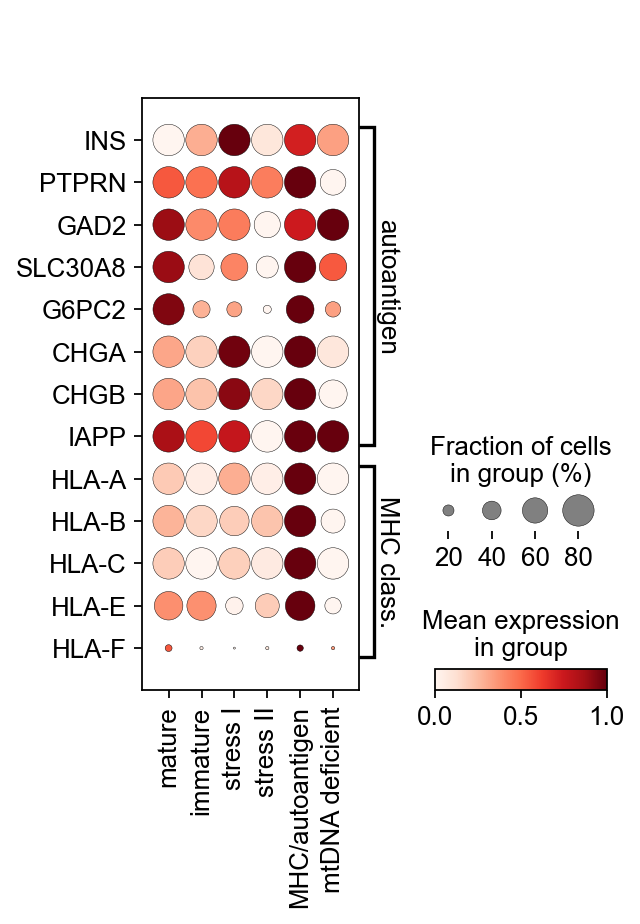

In [173]:
gene_dict ={'autoantigen': ['INS','PTPRN', 'GAD2', 'SLC30A8', 'G6PC2', 'CHGA', 'CHGB', 'IAPP'], 
            'MHC class I': ['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E', 'HLA-F']}
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', 
              var_names=gene_dict, standard_scale='var')
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', 
              var_names=gene_dict, standard_scale='var', swap_axes=True, dot_max=0.8)

### Hormone receptors

In [31]:
# manually curated form literature - list may be incomplete
hormone_receptors = {
    # adrenal gland
    '(nor)epinephrine' : ['ADRA1A', 'ADRA1B', 'ADRA1D', 'ADRA2A', 'ADRA2B', 'ADRA2C', 'ADRB1', 'ADRB2', 'ADRB3'],
    'dopamine' : ['DRD1', 'DRD2','DRD3', 'DRD4', 'DRD5'],
    
    #brain
    'gonadotrophin' : ['GNRHR1', 'GNRHR2'],
    'kisspeptin' : ['KISS1R'],
    'oxytocin' : ['OXTR'],
    'vasopressin' : ['AVPR1A', 'AVPR1B', 'AVPR2', 'CUL5', 'VACM1'],
    'corticotropin' : ['CRHR1'],
    'opioid':['OPRD1', 'OPRK1', 'OPRM1', 'OPRL1', 'OGFR'],
    'orexin' : ['HCRTR1', 'HCRTR2'],
    
    # pituitary gland
    'melanocortin' : ['MC1R', 'MC3R', 'MC4R', 'MC5R'],
    'ACTH' : ['MC2R'],
    'corticoid' : ['NR3C2', 'NR3C1'],
    'LH' :['LHCGR'], #luteinizing
    'FSH' : ['FSHR'], #follicle-stimulating
    'GH' : ['GHR'], #growth hormone
    'GH-releasing' : ['GHRHR'], #growth hormone-releasing
    'thyrotropin' : ['TSHR', 'TRHR'],
    
    # pineal gland 
    'melatonin' : ['MTNR1A', 'MTNR1B'],
    
    #ovaries
    'amh' : ['AMHR1', 'AMHR2'],
    'estrogen' : ['ESRRG', 'ESR1', 'ESRRA', 'ESR2'],
    'progesterone' : ['PGR'],
    'relaxin' : ['RXFP1', 'RXFP2', 'RXFP3', 'RXFP4'],
    
    #thyroid
    'thyroid' : ['THRA', 'THRB'],
    'calcitonin':['RAMP1', 'RAMP2', 'RAMP3', 'CALCR', 'CALCRL'],
    
    #parathyroid gland
    'parathyroid' : ['PTH1R', 'PTH2R'],
    
    #heart
    'natriuretic' : ['NPRL3', 'NPR3', 'NPR1', 'NPR2', 'NPRL2'],
    
    # liver
    'angiotensin' : ['AGTR1', 'ATGR2'],
    'hepcidin' : ['SLC40A1'],
    
    #kidney
    'epo' : ['EPOR'],
    'vitaminD ': ['VDR'],
    
    # intestinal
    'incretin' : ['GHSR', 'GIPR','GLP1R', 'GLP2R', 'SCTR', 'CCKAR', 'CCKBR', 'NPY1R', 'NPY2R', 'NPY5R'],
    'insl5/relaxin' : ['RXFP1', 'RXFP2', 'RXFP3', 'RXFP4'],
    'motilin' : ['MLNR'],
    'vip' : ['ADCYAP1R1', 'VIPR1', 'VIPR2'],
    'guanylin' : ['GUCY2C'],
    
    #pancreas
    'glucagon' : ['GCGR'],
    'ppy' : ['PPYR1'],
    'insulin' : ['INSR', 'INSRR', 'IGF1R', 'IGF2R', 'IGFLR1'],
    'somatostatin' : ['SSTR1', 'SSTR2', 'SSTR3', 'SSTR4', 'SSTR5'],
    
    #fat
    'adiponectin' : ['ADIPOR1', 'ADIPOR2', 'CDH13'],
    'leptin' : ['LEPR'],
    
    #blood
    'leukotirene' : ['TBXA2R'],
    
    #bone
    'osteocalcin' : ['GPRC6A'],
    
    # mulitple
    'serotonin' : ['HTR1A', 'HTR1B', 'HTR1D', 'HTR1F', 'HTR2A', 'HTR2B', 'HTR2C' 'HTR3A', 'HTR3B', 'HTR3D', 'HTR3E', 'HTR4', 'HTR5A', 'HTR5B', 'HTR6', 'HTR7'],
    'galanin' : ['GALR1', 'GALR2', 'GALR3'],
    'prostanoid' : ['PTGER3', 'PTGFR', 'PTGER4', 'PTGDR2', 'PTGDR', 'PTGER2', 'PTGER1', 'PTGIR'],
    'prolactin' : ['PRLR'],
    'androgen' : ['AR'],
    'thrombopoietin' : ['MPL'],
    'RA' : ['RARA', 'RARB', 'RARG'],
    'endothelin' : ['EDNRB', 'EDNRA']}

In [33]:
receptors_sub = {}
genes_all = []
for key in hormone_receptors.keys():
    genes = [gene for gene in hormone_receptors[key] if gene in adata_beta.var_names]
    if len(genes)>0:
        genes_all = genes_all + genes
df = pd.DataFrame(index = genes_all, columns=adata_beta.obs.louvain_anno_fine.cat.categories)
for key in adata_beta.obs.louvain_anno_fine.cat.categories:
    genes_frac = (adata_beta[adata_beta.obs.louvain_anno_fine.isin([key]), genes_all].copy().X > 0).sum(0) / adata_beta.obs.louvain_anno_fine.value_counts()[key]
    df[key] = genes_frac.A1
df_det = df>0.05
detected = df_det.index[df_det.any(axis=1)].tolist()

for key in hormone_receptors.keys():
    genes = [gene for gene in hormone_receptors[key] if (gene in adata_beta.var_names) & (gene in detected)]
    if len(genes)>0:
        receptors_sub[key]=genes

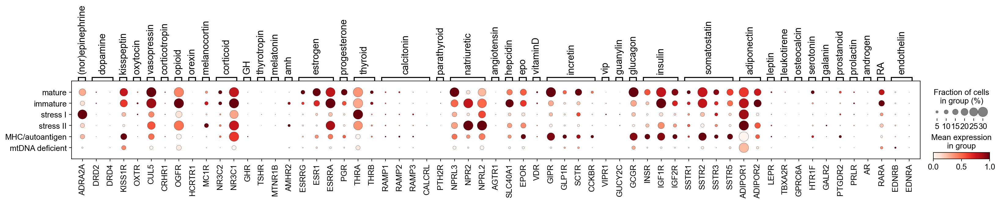

In [34]:
sc.pl.dotplot(adata_beta, var_names=receptors_sub, 
              groupby='louvain_anno_fine', standard_scale='var', dot_max=0.3)

### Beta cell disallowed genes

In [35]:
# disallowed
disallowed = ['ARHGDIB', 'CAT', 'CXCL12', 'DAPK2', 'FAM13A', 'FCGRT', 'GAS1',
       'HPGD', 'HSD11B1',  'IGFBP4', 'LDHA', 'LMO4', 'LRIG3',
       'MAF', 'MGLL', 'NDRG2', 'OAT',  'PDGFRA', 'RARRES2',
       'SLC16A1', 'SMAD3', 'SMOC2', 'TERF1', 'TF', 'TPM2', 'YAP1',
       'ZCCHC24', 'ZFP36L1', 'ZYX', 'DNMT3A'] #'IGF1','OLFML1','RASGRP2', 

In [14]:
len(disallowed)

30

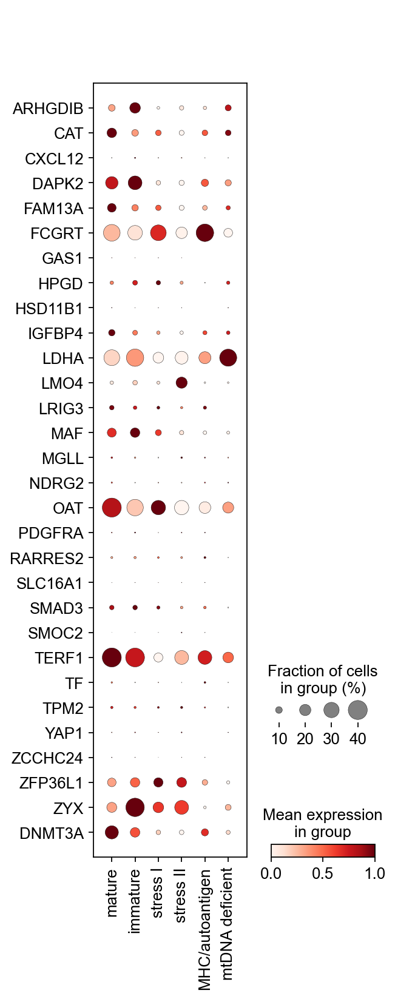

In [36]:
sc.pl.dotplot(adata_beta, var_names=disallowed,
              groupby='louvain_anno_fine', standard_scale='var', dot_max=0.4, swap_axes=True)

### General transcription and translation factors

In [84]:
adata_beta_2 = adata_beta.copy()
sc.pp.filter_genes(adata_beta_2, min_cells=500)

filtered out 7535 genes that are detected in less than 500 cells


In [85]:
rna_expression = {
    'RNA\npolymerase': sorted([gene for gene in adata_beta_2.var_names if gene.startswith('POLR2')]),
    'transcription\nfactors': ['GTF2A1', 'GTF2A2', 'GTF2B', 'TBP','GTF2E1', 'GTF2E2', 'GTF2F1', 
                              'GTF2F2', 'GTF2H1', 'GTF2H2', 'GTF2H2C', 'GTF2H3', 'GTF2H5'],
    'translation\nfactors': sorted([gene for gene in adata_beta_2.var_names if gene.startswith('EIF')]),
}

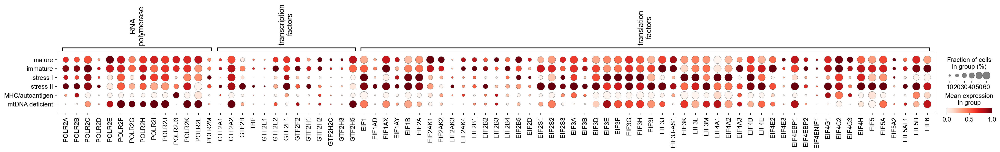

In [86]:
sc.pl.dotplot(adata_beta_2, groupby='louvain_anno_fine', 
              var_names=rna_expression, standard_scale='var', dot_max=0.6)

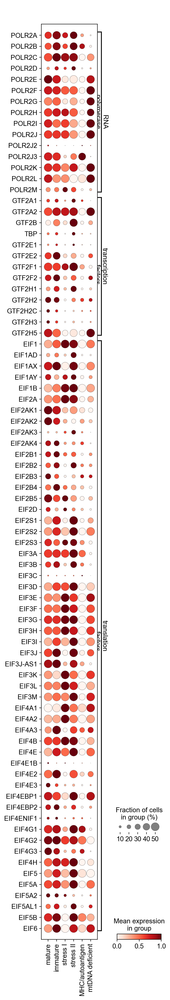

In [83]:
sc.pl.dotplot(adata_beta_2, groupby='louvain_anno_fine', 
              var_names=rna_expression, standard_scale='var', dot_max=0.5, swap_axes=True)

### ER stress response pathways

In [11]:
genes_ire = ['ERN1', 'TRAF2', 'MAP3K5', 'JUN']
genes_perk = ['EIF2AK3', 'EIF2A', 'ATF4', 'DDIT3', 'PPP1R15A', 'PPP1CC']
genes_atf6 = ['ATF6', 'XBP1', 'HSPA5']

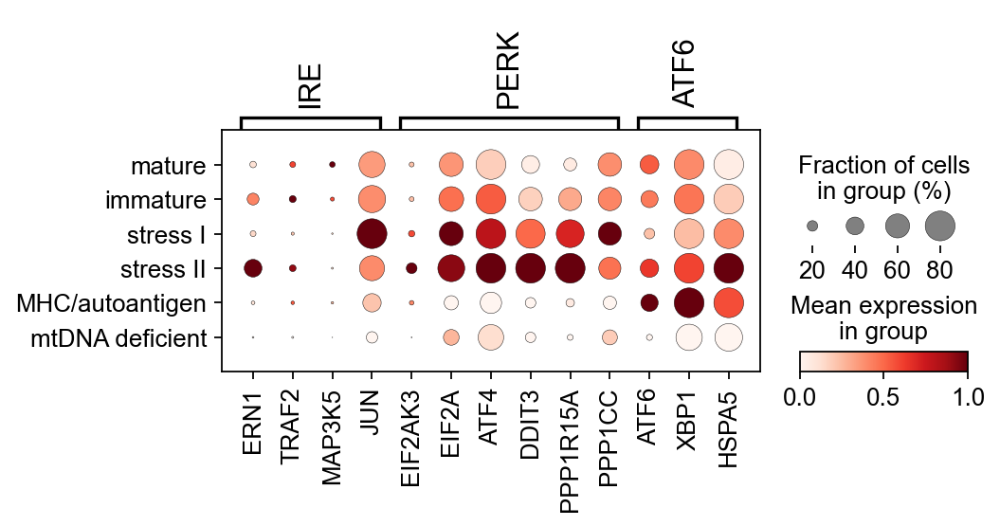

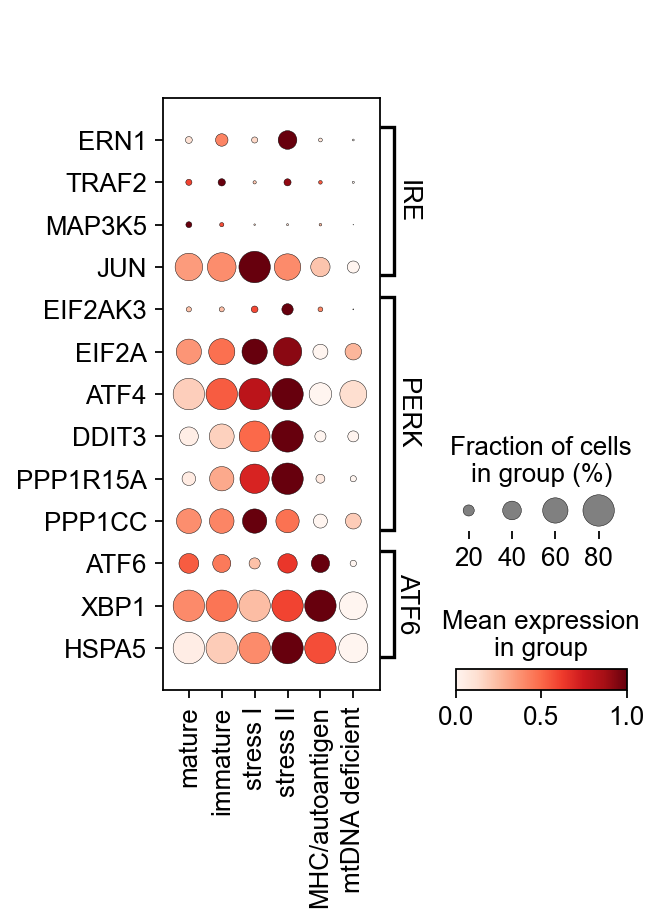

In [17]:
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', 
              var_group_labels=['IRE', 'PERK', 'ATF6'],
              var_group_positions=[(0,3), (4,9), (10,12)],dot_max=0.8,
              var_names=genes_ire+genes_perk+genes_atf6, standard_scale='var', var_group_rotation=90)

sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', 
              var_group_labels=['IRE', 'PERK', 'ATF6'],
              var_group_positions=[(0,3), (4,9), (10,12)],dot_max=0.8,
              var_names=genes_ire+genes_perk+genes_atf6, standard_scale='var', swap_axes=True)

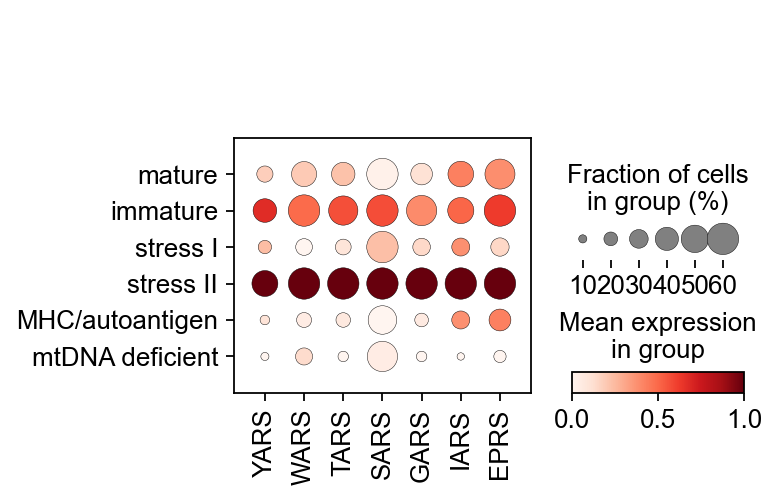

In [37]:
# tRNA-acylation
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine' ,dot_max=0.6,
              var_names=['YARS','WARS','TARS','SARS','GARS','IARS','EPRS'], standard_scale='var')

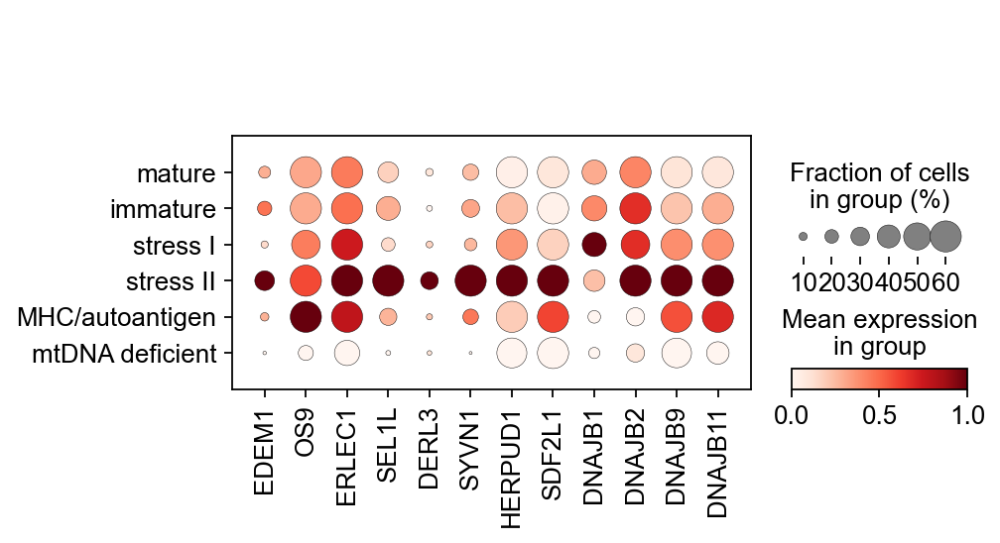

In [38]:
# ERAD
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine' ,dot_max=0.6,
              var_names=['EDEM1','OS9','ERLEC1','SEL1L','DERL3','SYVN1','HERPUD1',
                         'SDF2L1','DNAJB1','DNAJB2','DNAJB9','DNAJB11'], standard_scale='var')

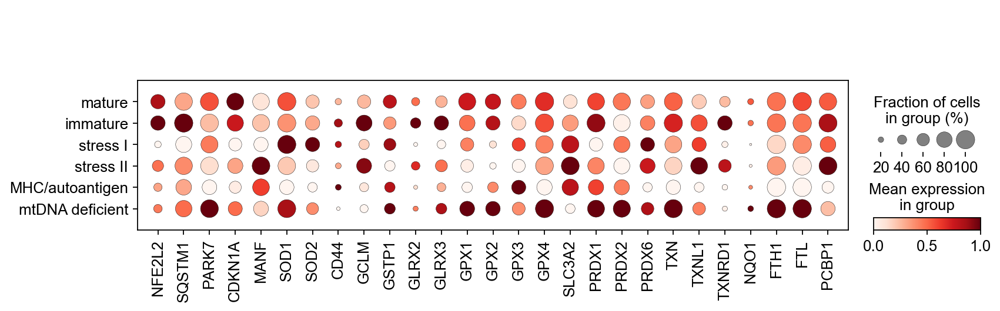

In [39]:
# Oxidative stress response
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', var_names=['NFE2L2','SQSTM1', 'PARK7', 'CDKN1A','MANF','SOD1','SOD2','CD44',
                                                                  'GCLM', 'GSTP1', 'GLRX2', 'GLRX3', 'GPX1', 'GPX2', 'GPX3', 'GPX4','SLC3A2','PRDX1', 'PRDX2',
                                                                  'PRDX6', 'TXN', 'TXNL1', 'TXNRD1','NQO1','FTH1', 'FTL', 'PCBP1'], cmap='Reds', standard_scale='var')

## GO stress pathway scoring

In [191]:
# load pathways
df = pd.read_csv('.data/c5.go.bp.v7.2.symbols.gmt', sep='\n', header=None)
df = df[0].str.split('\t', expand=True)

In [192]:
# dict from GO pathways, only include pathways with >3 genes expressed and with a gene representation of >30%
hall_mark_dict = {}

for i in range(0,df.shape[0]):
    genes = [i for i in df.loc[i,2:].tolist() if i]
    n_genes = np.sum([gene in adata_beta.var_names for gene in genes])
    len_genes = len(genes)
    ratio = n_genes/len_genes
    if n_genes>3:
        if ratio>0.3:
            if len_genes<200:
                hall_mark_dict[df.loc[i,0]] = [gene for gene in genes if gene in adata_beta.var_names]

In [383]:
for key in ['GO_PERK_MEDIATED_UNFOLDED_PROTEIN_RESPONSE', 'GO_IRE1_MEDIATED_UNFOLDED_PROTEIN_RESPONSE', 'GO_ATF6_MEDIATED_UNFOLDED_PROTEIN_RESPONSE', 'GO_ERAD_PATHWAY']:
    sc.tl.score_genes(adata_beta, gene_list=[gene for gene in hall_mark_dict[key] if gene in adata_beta.var_names], score_name=f'STRESS_{key}')

computing score 'STRESS_GO_PERK_MEDIATED_UNFOLDED_PROTEIN_RESPONSE'
    finished (0:00:04)
computing score 'STRESS_GO_IRE1_MEDIATED_UNFOLDED_PROTEIN_RESPONSE'
    finished (0:00:04)
computing score 'STRESS_GO_ATF6_MEDIATED_UNFOLDED_PROTEIN_RESPONSE'
    finished (0:00:04)
computing score 'STRESS_GO_ERAD_PATHWAY'
    finished (0:00:04)


In [385]:
go_terms = [obs for obs in adata_beta.obs.columns if obs.startswith('STRESS')]
beta_go = sc.AnnData(adata_beta.obs[go_terms], vidx= go_terms, oidx = adata_beta.obs_names)
beta_go.obs['louvain_anno_fine'] = adata_beta.obs['louvain_anno_fine']
beta_go.obs['donor'] = adata_beta.obs['donor']
beta_go.obsm = adata_beta.obsm
beta_go.var_names = [str(x.split('_', 1)[1]) for x in beta_go.var_names]

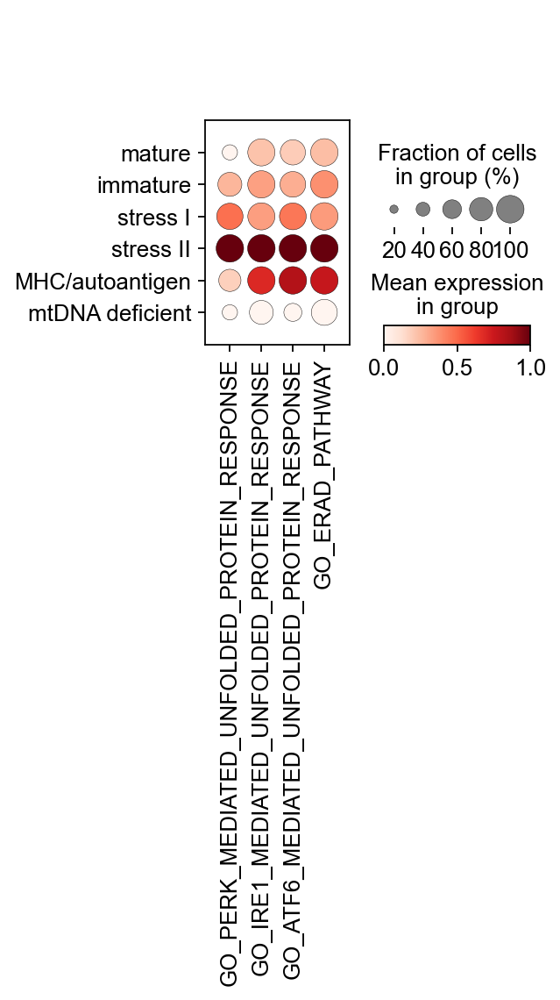

In [386]:
sc.pl.dotplot(beta_go, groupby='louvain_anno_fine', var_names=list(beta_go.var_names), standard_scale='var')

## Glucocorticoid signaling profile

Table S6 downloaded from Aylward et al. 2021, https://journals.plos.org/plosgenetics/article?id=10.1371/journal.pgen.1009531#sec007

In [388]:
df_gc = pd.read_excel('./data/journal.pgen.1009531.s014.xlsx', skiprows=2, index_col=0).iloc[:, 0:6]

In [366]:
gc_dict = {'STAT': ['STAT1', 'STAT3', 'STAT4', 'STAT5B'],
           'TGFB': ['TGFB1', 'SMAD3', 'SMAD5', 'SMAD7', 'SMAD9', 'ID1', 'ID2', 'ID3', 'BMPR1A'], 
           'other growth\nfactors': ['VEGFA', 'VEGFB', 'PDGFA', 'FGF1', 'FGF2', 'FGF14']}

In [377]:
for k,v in gc_dict.items():
    display(df_gc.loc[v])

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
gene,,,,,,
STAT1,3307.571683,-0.207933,0.060656,-3.428083,0.000608,0.006832
STAT3,7011.642152,-0.121639,0.044295,-2.746087,0.006031,0.046372
STAT4,484.627704,-0.397945,0.081546,-4.879992,0.000001,0.000023
STAT5B,2071.208599,-0.244438,0.053538,-4.565731,0.000005,0.000097


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
gene,,,,,,
TGFB1,321.997500,-0.361645,0.130631,-2.768454,5.632290e-03,4.404600e-02
SMAD3,622.331010,-0.502044,0.089764,-5.592946,2.232486e-08,6.953722e-07
SMAD5,2608.391256,-0.139022,0.044885,-3.097259,1.953191e-03,1.827385e-02
SMAD7,705.536901,-0.274454,0.065456,-4.192946,2.753546e-05,4.582855e-04
SMAD9,745.266883,-0.423198,0.085429,-4.953790,7.278179e-07,1.659350e-05
ID1,2244.453970,-0.734115,0.125831,-5.834110,5.407830e-09,1.857773e-07
ID2,1725.329315,-0.527966,0.108135,-4.882488,1.047556e-06,2.325390e-05
ID3,828.147314,-0.357660,0.088176,-4.056184,4.988098e-05,7.802778e-04
BMPR1A,1489.234197,-0.229489,0.054648,-4.199413,2.676073e-05,4.470734e-04


,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
gene,,,,,,
VEGFA,7688.404564,-0.349510,0.067963,-5.142643,2.709003e-07,6.750377e-06
VEGFB,602.531016,-0.305046,0.091375,-3.338377,8.426928e-04,9.024770e-03
PDGFA,746.466579,-0.259313,0.072631,-3.570273,3.566093e-04,4.345132e-03
FGF1,28.419517,-1.023314,0.241101,-4.244334,2.192432e-05,3.733254e-04
FGF2,538.984699,-0.868943,0.151491,-5.735955,9.696418e-09,3.194582e-07
FGF14,824.324385,-0.358734,0.066875,-5.364207,8.130570e-08,2.254640e-06


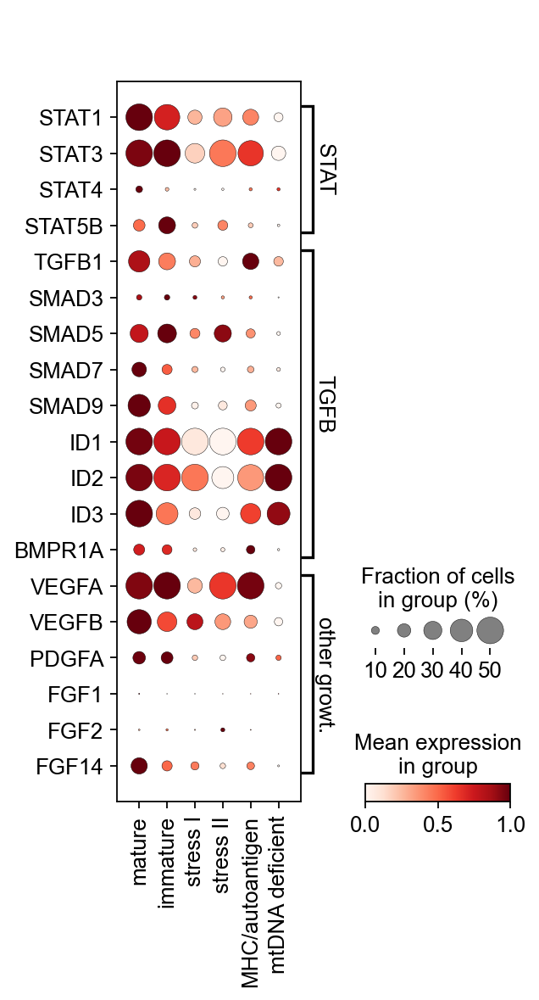

In [373]:
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', var_names = gc_dict, 
              standard_scale='var', dot_max=0.5, swap_axes=True)

In [379]:
sc.tl.rank_genes_groups(adata_beta, groupby='louvain_anno_fine', groups=['stress I'], reference='mature', method='wilcoxon')

ranking genes
    finished (0:00:10)


In [380]:
df_stressI = sc.get.rank_genes_groups_df(adata_beta, group='stress I').set_index('names')

In [381]:
for k,v in gc_dict.items():
    display(df_stressI.loc[v])

,scores,logfoldchanges,pvals,pvals_adj
names,,,,
STAT1,-17.769356,-1.266323,1.220861e-70,2.906565e-69
STAT3,-25.374599,-1.542190,4.810748e-142,2.823174e-140
STAT4,-3.673382,-1.899563,2.393612e-04,6.243040e-04
STAT5B,-5.783357,-0.997267,7.322462e-09,2.662937e-08


,scores,logfoldchanges,pvals,pvals_adj
names,,,,
TGFB1,-11.359154,-0.990834,6.678881e-30,6.077617e-29
SMAD3,-1.120670,0.097515,2.624282e-01,4.401752e-01
SMAD5,-8.420183,-0.692577,3.758975e-17,2.115658e-16
SMAD7,-8.616489,-1.263718,6.903829e-18,4.028399e-17
SMAD9,-17.848085,-2.217416,2.991166e-71,7.271533e-70
ID1,-40.865528,-3.355006,0.000000e+00,0.000000e+00
ID2,-19.153423,-1.110942,9.062850e-82,2.629939e-80
ID3,-22.521160,-2.433681,2.575339e-112,1.095976e-110
BMPR1A,-6.840057,-1.784279,7.916184e-12,3.405031e-11


,scores,logfoldchanges,pvals,pvals_adj
names,,,,
VEGFA,-26.018238,-1.799873,3.079525e-149,1.917108e-147
VEGFB,-7.392088,-0.190034,1.445401e-13,6.839858e-13
PDGFA,-6.925974,-1.072466,4.329854e-12,1.893810e-11
FGF1,-0.179737,-0.995157,8.573588e-01,9.997715e-01
FGF2,-0.248103,0.013111,8.040546e-01,9.997715e-01
FGF14,-8.569188,-1.008605,1.042176e-17,6.020117e-17


## cAMP signaling

In [479]:
adata_beta_2 = adata_beta.copy()
sc.pp.filter_genes(adata_beta_2, min_cells=200)

filtered out 5632 genes that are detected in less than 200 cells


In [430]:
adata_beta.obs.louvain_anno_fine.value_counts()

mature             6999
immature           1711
stress I           1331
stress II          1259
MHC/autoantigen     349
mtDNA deficient     274
Name: louvain_anno_fine, dtype: int64

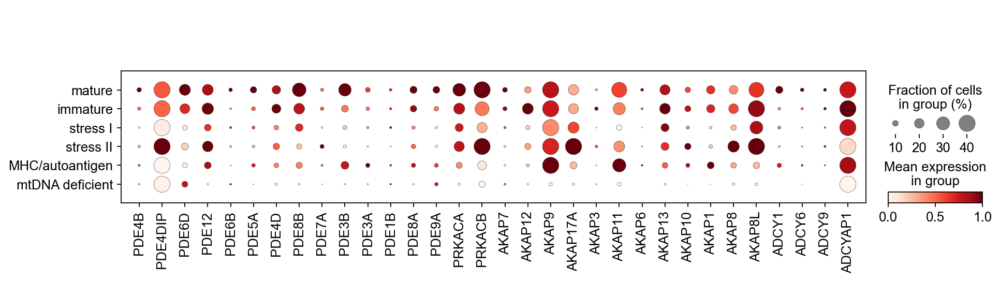

In [450]:
sc.pl.dotplot(adata_beta_2, groupby='louvain_anno_fine', 
              var_names=[gene for gene in adata_beta_2.var_names if gene.startswith('PDE')]+['PRKACA', 'PRKACB']+[gene for gene in adata_beta_2.var_names if gene.startswith('AKAP')]+[gene for gene in adata_beta_2.var_names if gene.startswith('ADCY')], 
              standard_scale='var', dot_max=0.4)

In [453]:
gene_dict = {'PKA': ['PRKACA', 'PRKACB', 'PRKAR1A', 'PRKAR1B', 'PRKAR2A', 'PRKAR2B'],
             'PKA scaffolds\nPKA localization': ['AKAP1','AKAP3', 'AKAP6', 'AKAP7', 'AKAP8', 'AKAP9', 'AKAP10', 'AKAP11', 'AKAP12', 'AKAP13', 'AKAP17A'], 
             'Adenylyl cyclases\ncAMP generation': ['ADCY1', 'ADCY6', 'ADCY9'],
             'Phospohdiesterase\ncAMP break down':  ['PDE1B', 'PDE3A', 'PDE3B', 'PDE4B', 'PDE4D', 'PDE5A', 'PDE6B', 'PDE6D', 'PDE7A', 'PDE8A', 'PDE8B', 'PDE9A', 'PDE12']}

In [ ]:
sc.pl.dotplot(adata_beta_2, groupby='louvain_anno_fine', var_names=gene_dict,
              standard_scale='var', dot_max=0.4)

## Score for GO hallmarks

In [185]:
df = pd.read_csv('/data/h.all.v7.2.symbols.gmt', sep='\n', header=None)
df = df[0].str.split('\t', expand=True)

In [186]:
hall_mark_dict = {}

for i in range(0,df.shape[0]):
    genes = [i for i in df.loc[i,2:].tolist() if i]
    n_genes = np.sum([gene in adata_beta.var_names for gene in genes])
    len_genes = len(genes)
    ratio = n_genes/len_genes
    if n_genes>2:
        if ratio>0.05:
            hall_mark_dict[df.loc[i,0]] = [gene for gene in genes if gene in adata_beta.var_names]

In [189]:
%%time
sc.settings.verbosity=0
for key in hall_mark_dict.keys():
    sc.tl.score_genes(adata_beta, gene_list=[gene for gene in hall_mark_dict[key] if gene in adata_beta.var_names], score_name=key)

CPU times: user 2min 36s, sys: 1min 13s, total: 3min 50s
Wall time: 3min 58s


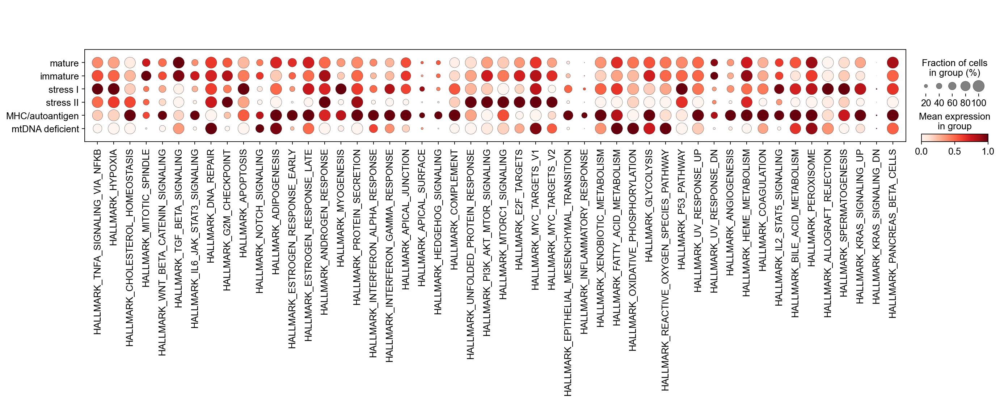

In [190]:
go_terms = [obs for obs in adata_beta.obs.columns if obs.startswith('HALLMARK')]
beta_go = sc.AnnData(adata_beta.obs[go_terms], vidx= go_terms, oidx = adata_beta.obs_names)
beta_go.obs['louvain_anno_fine'] = adata_beta.obs['louvain_anno_fine']
beta_go.obs['donor'] = adata_beta.obs['donor']
beta_go.obsm = adata_beta.obsm
# sc.pp.neighbors(beta_go, use_rep='X')
# sc.tl.umap(beta_go)
sc.pl.dotplot(beta_go, groupby='louvain_anno_fine', var_names=list(beta_go.var_names), 
              standard_scale='var', dendrogram=0)

In [191]:
beta_go.var_names = [g.split('_',1)[1] for g in beta_go.var_names]

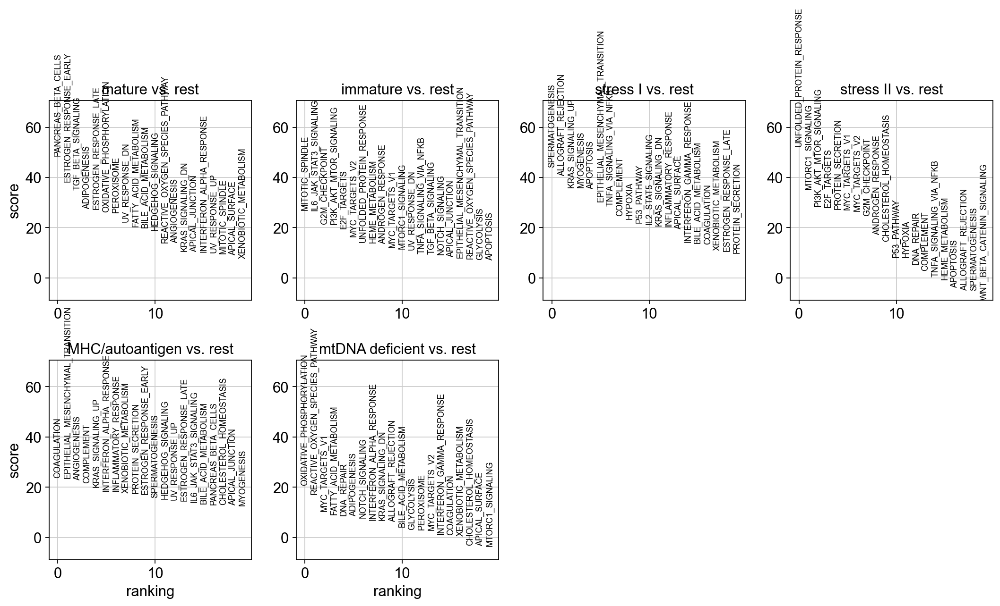

In [192]:
sc.tl.rank_genes_groups(beta_go, groupby='louvain_anno_fine', method='wilcoxon')
sc.pl.rank_genes_groups(beta_go)

In [193]:
go_markers = []
for cat in beta_go.obs.louvain_anno_fine.cat.categories:
    go_markers = go_markers + sc.get.rank_genes_groups_df(beta_go, group=cat)['names'].tolist()[0:5]

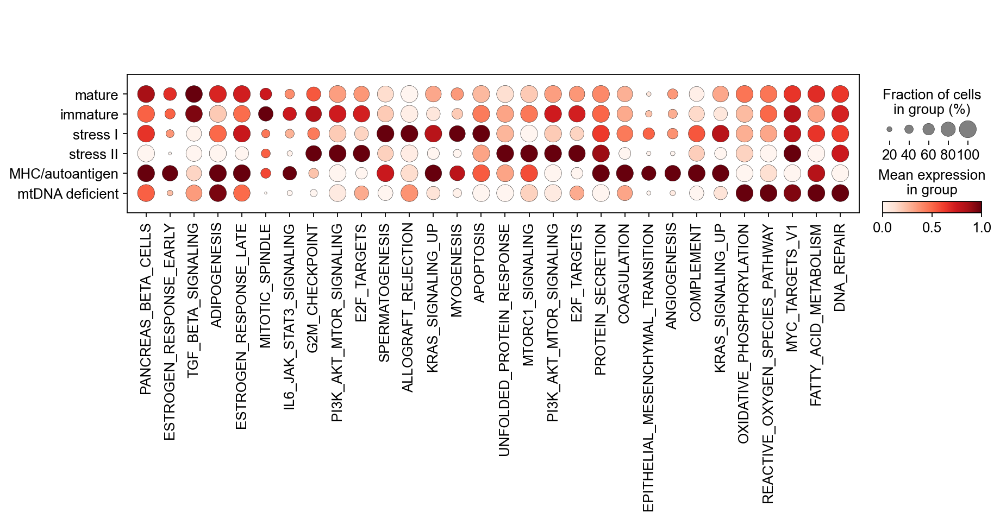

In [197]:
sc.pl.dotplot(beta_go, groupby='louvain_anno_fine', var_names=go_markers, 
              standard_scale='var')

## Gene-gene correlation sets

In [318]:
adata_beta_2 = adata_beta.copy()
sc.pp.filter_genes(adata_beta_2, min_cells=20)
sc.pp.highly_variable_genes(adata_beta_2, n_top_genes=3000)
adata_beta_hvg = adata_beta_2[:,adata_beta_2.var.highly_variable].copy()
del adata_beta_2

filtered out 1258 genes that are detected in less than 20 cells


In [372]:
df = adata_beta_hvg.to_df().T

In [373]:
df_corr = np.corrcoef(df)

In [323]:
from scipy.spatial import distance
from scipy.cluster import hierarchy

dist = distance.pdist(df_corr, metric='euclidean')
row_linkage = hierarchy.linkage(dist, method='ward')

In [384]:
clusters = hierarchy.fcluster(row_linkage, 0.8*dist.max(), 'distance')
np.unique(clusters)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19], dtype=int32)

In [385]:
df_corr = pd.DataFrame(df_corr)

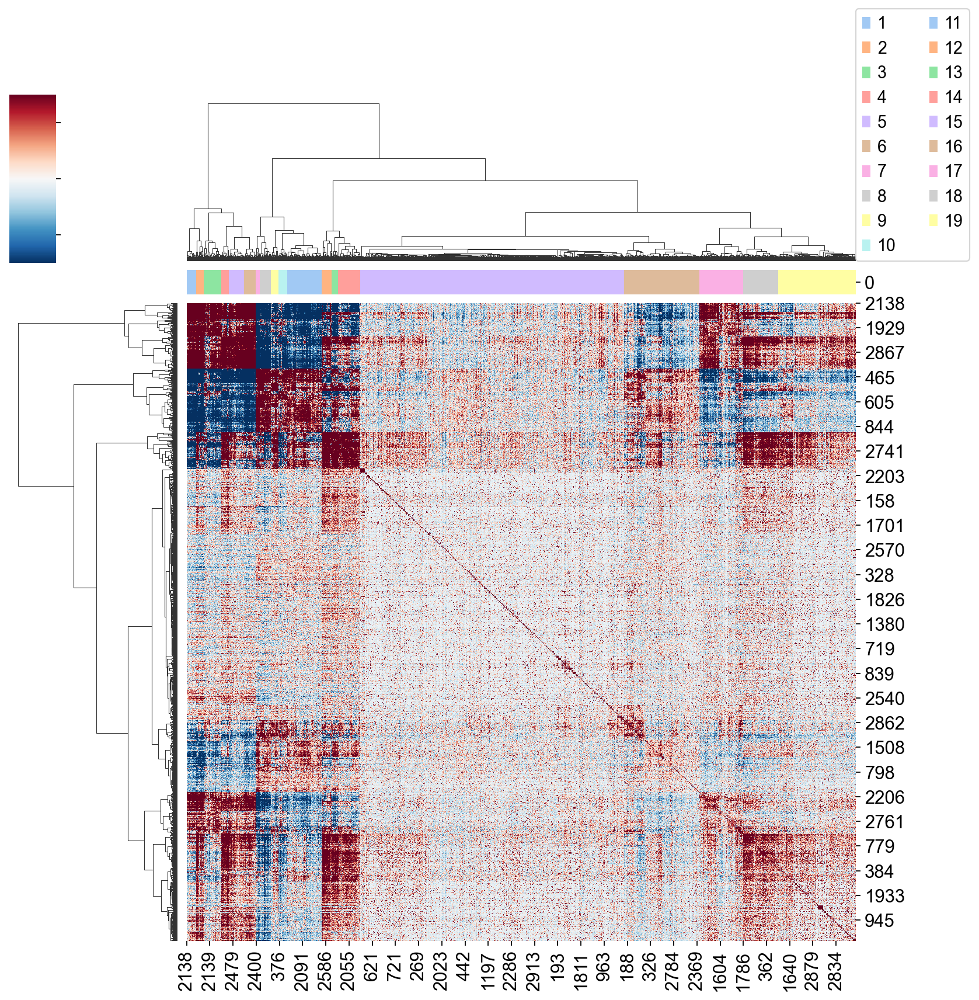

In [386]:
# set colors for heatmap
col_dict = dict(zip(set(clusters), sns.color_palette('pastel', n_colors=len(np.unique(clusters)))))
col_colors = pd.DataFrame(clusters, index=df_corr.index)[0].map(col_dict)

g = sns.clustermap(df_corr, row_linkage=row_linkage, col_linkage=row_linkage, 
               col_colors=col_colors,
               cmap='RdBu_r', vmin=-0.03, vmax=0.03)

for label in col_dict.keys():
    g.ax_col_dendrogram.bar(0, 0, color=col_dict[label],
                            label=label, linewidth=0)
    
g.cax.set_xticklabels([])
g.cax.set_yticklabels([])
g.cax.set_xticks([])
g.cax.set_yticks([])


g.ax_col_dendrogram.legend(loc=(1,0), ncol=2)

### correlation mean

In [388]:
df_corr.index = adata_beta_hvg.var_names
df_corr.columns = adata_beta_hvg.var_names
df_corr['gene set'] = [f'G{clu}' for clu in clusters]
df_corr_gr = df_corr.groupby(['gene set']).mean().T
df_corr_gr['gene set'] = [f'G{clu}' for clu in clusters]

In [389]:
df_corr_gr_mean = df_corr_gr.groupby(['gene set']).mean()

In [390]:
df_corr_gr_mean = df_corr_gr_mean.loc[['G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10', 'G11', 'G12', 'G13', 'G14', 'G15', 'G16', 'G17', 'G18', 'G19'], 
                                      ['G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10', 'G11', 'G12', 'G13', 'G14', 'G15', 'G16', 'G17', 'G18', 'G19']]

In [406]:
df_corr_gr_mean.style.background_gradient(cmap='coolwarm', axis=1, vmin=-0.15, vmax=0.15).format('{:.2g}')

In [411]:
df_diag = pd.DataFrame(np.diag(df_corr_gr_mean), index = df_corr_gr_mean.index)

In [412]:
df_diag.style.background_gradient(cmap='coolwarm', axis=1, vmin=-0.15, vmax=0.15).format('{:.2g}')

,0
gene set,
G1,0.23
G2,0.35
G3,0.085
G4,0.22
G5,0.079
G6,0.17
G7,0.31
G8,0.16
G9,0.15


### save

In [391]:
workbook = xlsxwriter.Workbook('./output_files/gene_sets_beta.xlsx')

worksheet = workbook.add_worksheet()

row = 0
col = 0

for key in range(1,len(np.unique(clusters))+1):
    row = 0
    worksheet.write(row, col, key)
    for item in adata_beta_hvg.var_names[clusters==key].tolist():
        worksheet.write(row+1, col, item)
        row += 1
    col += 1
workbook.close()

### enrich

In [9]:
df_gene_set = pd.read_excel('./output_files/gene_sets_beta.xlsx')

In [15]:
enr_dict_go = {}

for i in df_gene_set.columns:
    genes = df_gene_set[i].dropna().tolist()
    enr = gp.enrichr(gene_list=genes, gene_sets='GO_Biological_Process_2018', organism='human')
    enr_dict_go[str(i)]=enr.res2d   

2022-02-06 19:33:48,183 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:33:55,359 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:34:17,044 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:34:24,071 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:34:47,274 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:34:51,756 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  # This is added back by InteractiveShellApp.init_path()


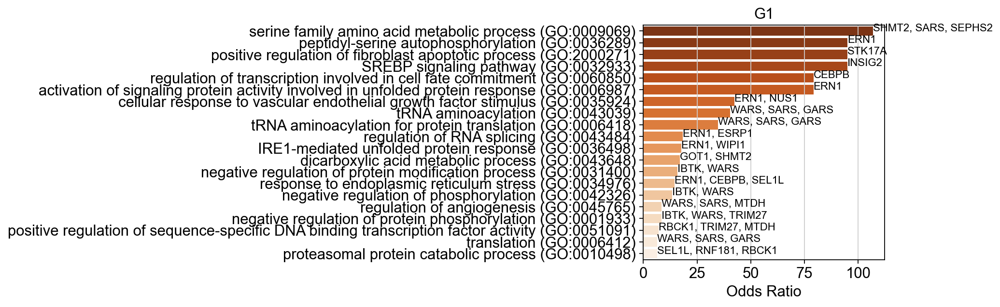

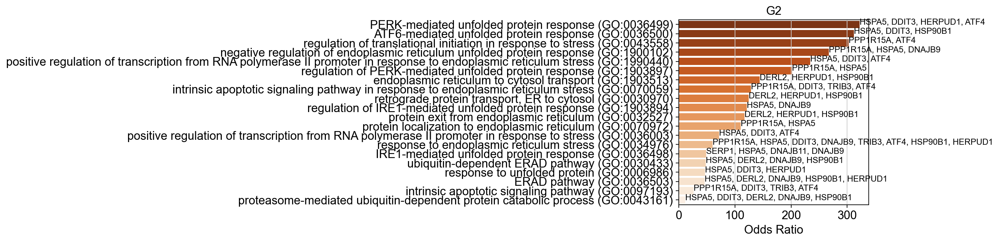

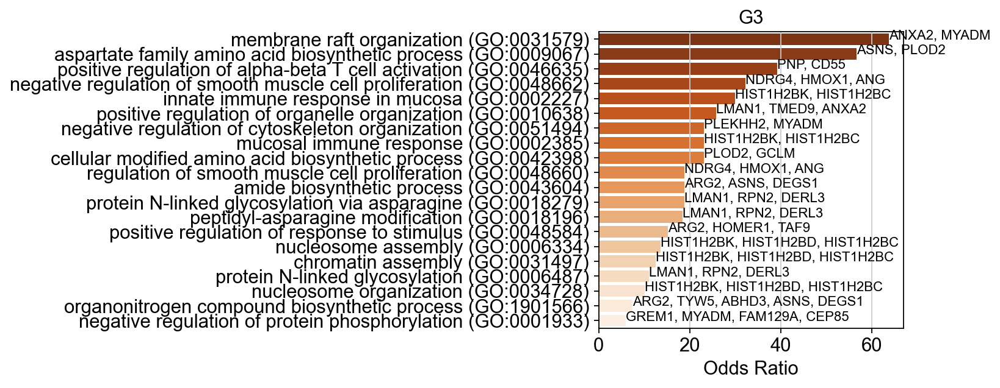

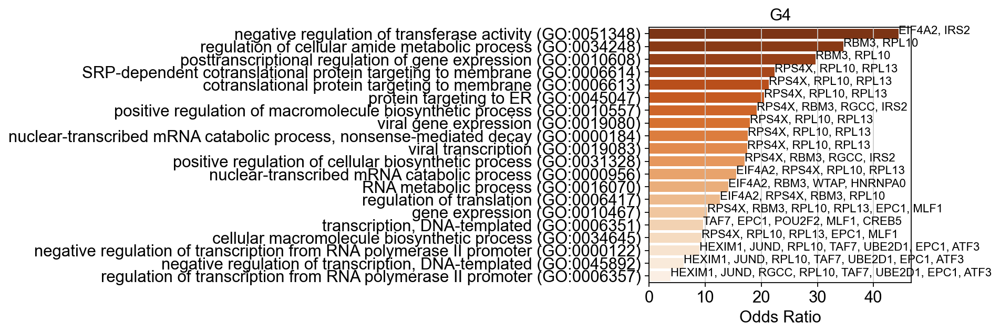

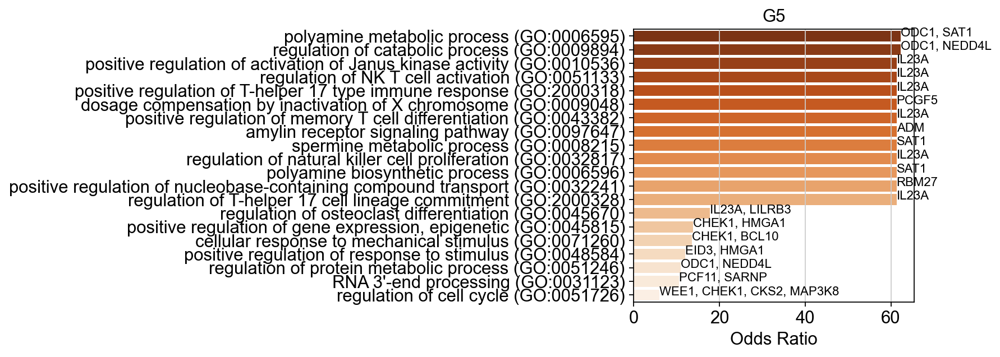

...

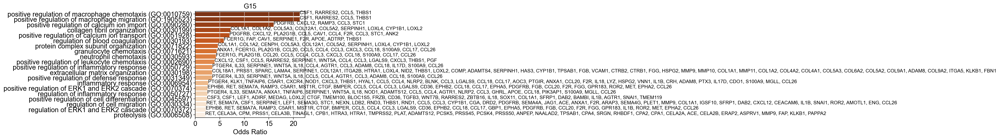

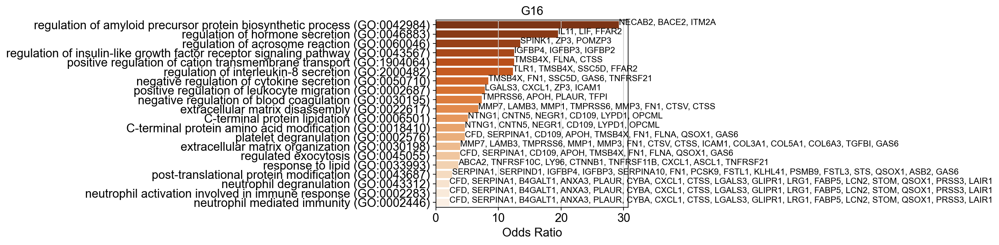

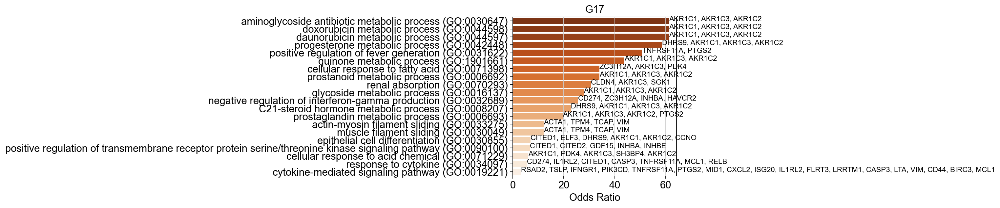

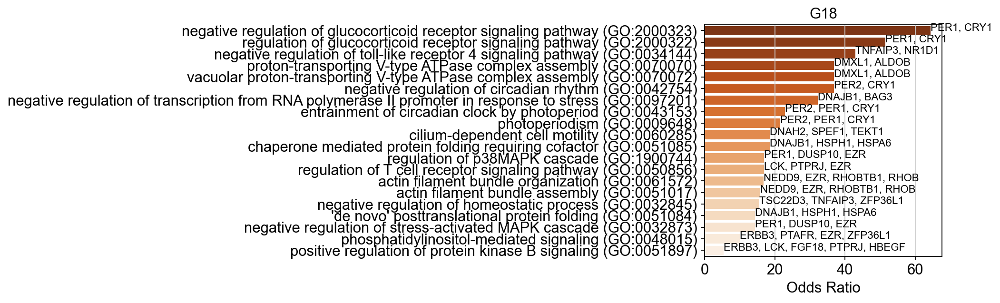

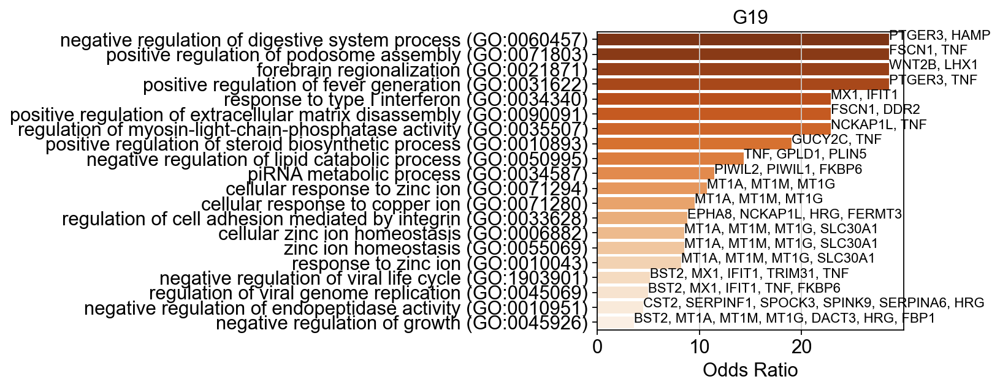

In [17]:
for key in enr_dict_go.keys():
    fig,axs = pl.subplots()
    sns.barplot(data=enr_dict_go[key].head(20).sort_values(by='Odds Ratio', ascending=False),
                y='Term', x='Odds Ratio', orient='horizontal', palette='Oranges_r', ax=axs)
    i=0
    for index, row in enr_dict_go[key].head(20).sort_values(by='Odds Ratio', ascending=False).iterrows():
        axs.text(row['Odds Ratio'], i, row.Genes.replace(';', ', '), color='black', ha="left", fontsize=10)
        i+=1
    pl.ylabel('')
    pl.title(f'G{key}')
    pl.tight_layout()

In [21]:
enr_dict_kegg = {}
for i in df_gene_set.columns:
    genes = df_gene_set[i].dropna().tolist()
    enr = gp.enrichr(gene_list=genes, gene_sets='KEGG_2019_Human', organism='human')
    enr_dict_kegg[str(i)]=enr.res2d

2022-02-06 19:39:36,375 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:39:39,697 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:39:46,292 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:40:07,863 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:40:21,432 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:40:32,977 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  if sys.path[0] == '':


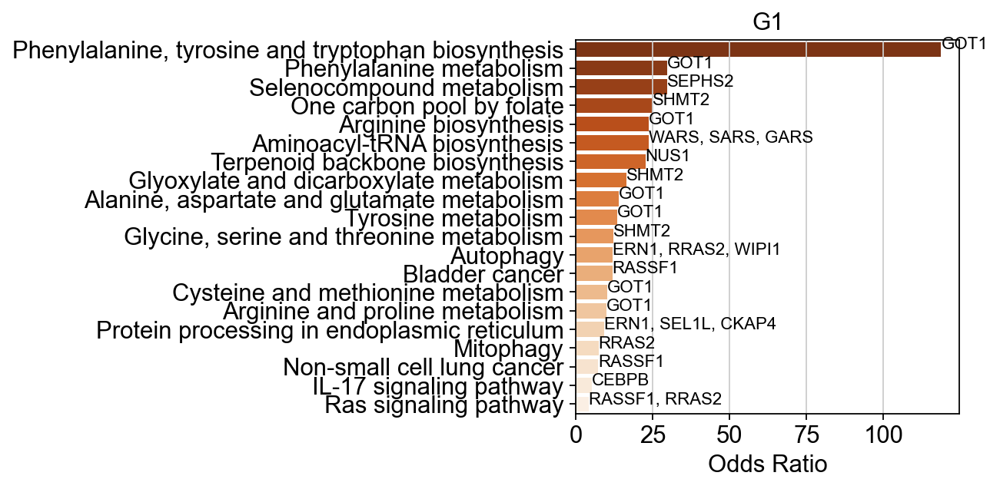

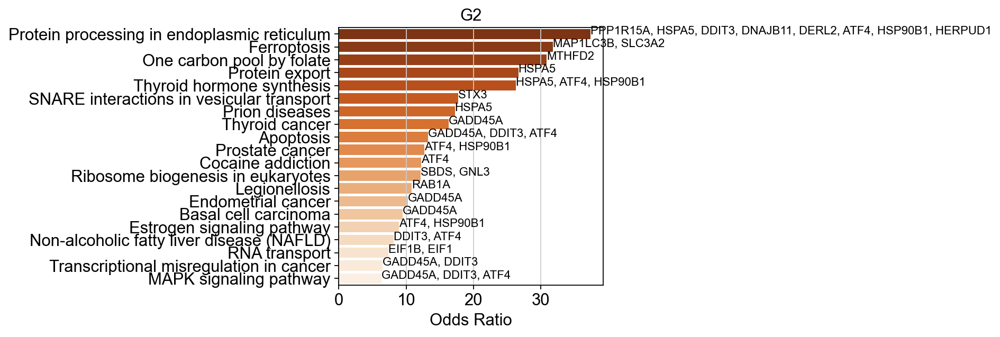

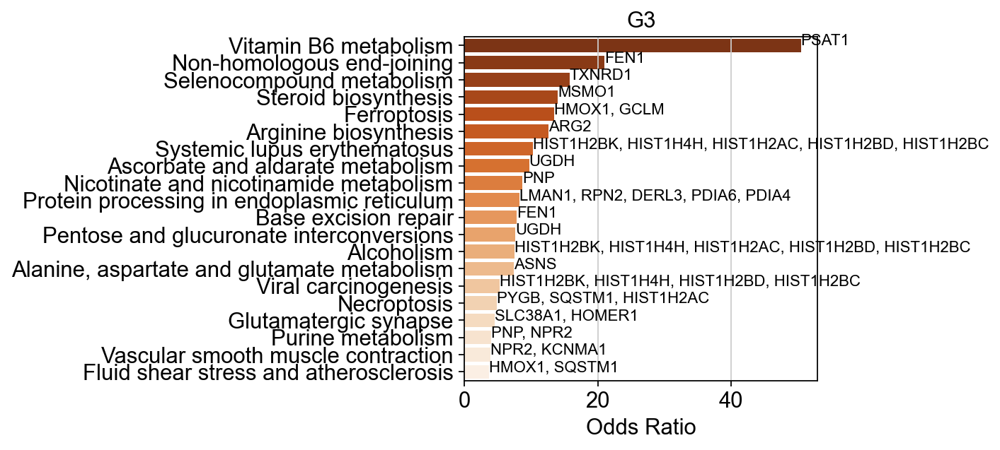

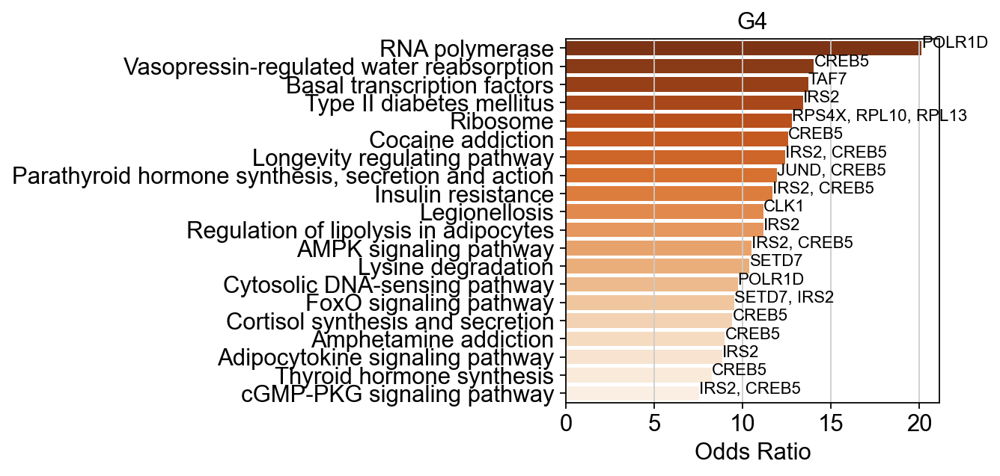

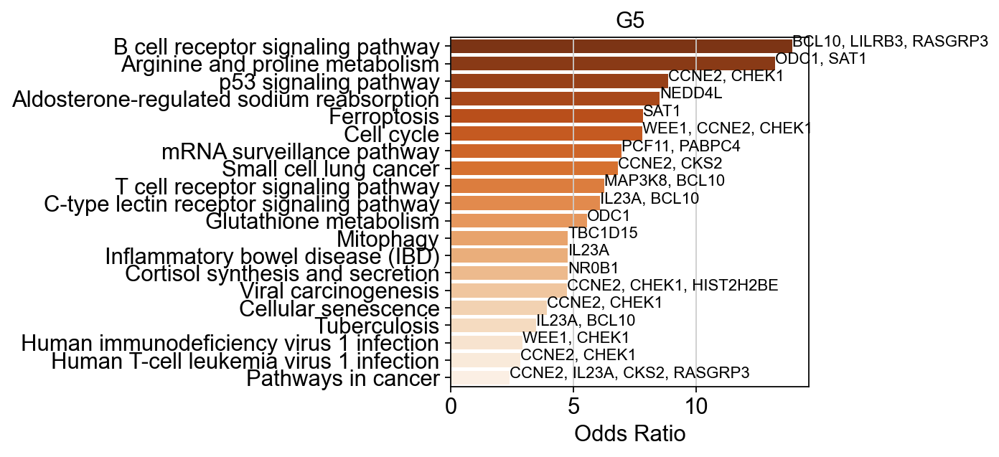

...

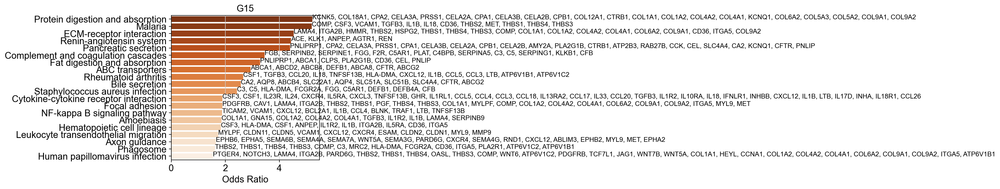

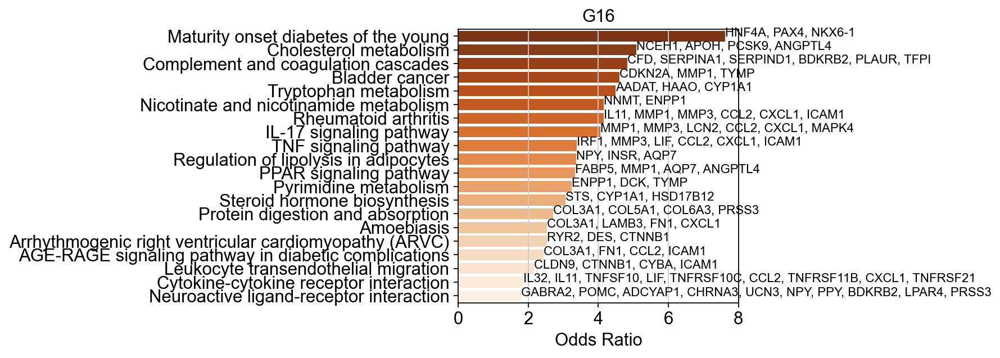

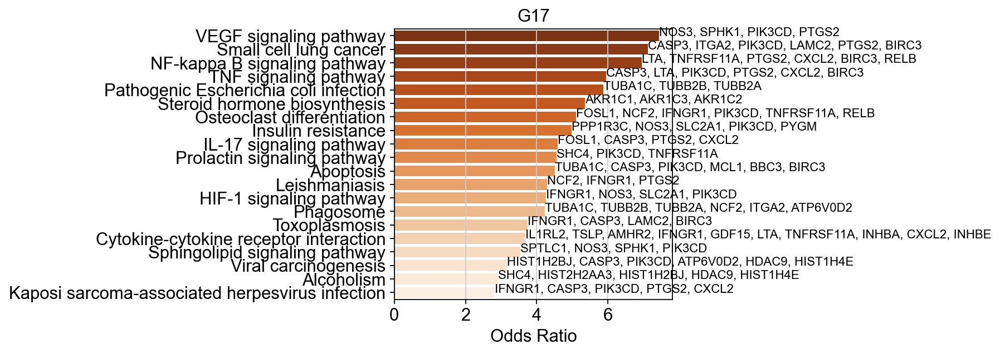

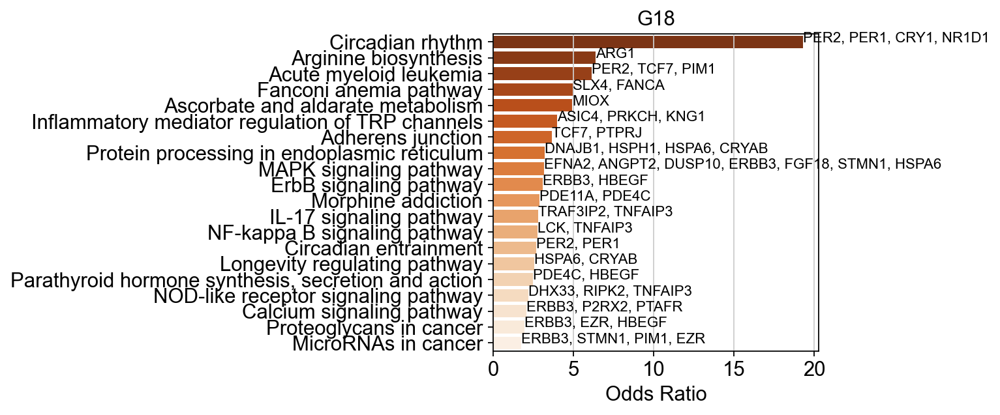

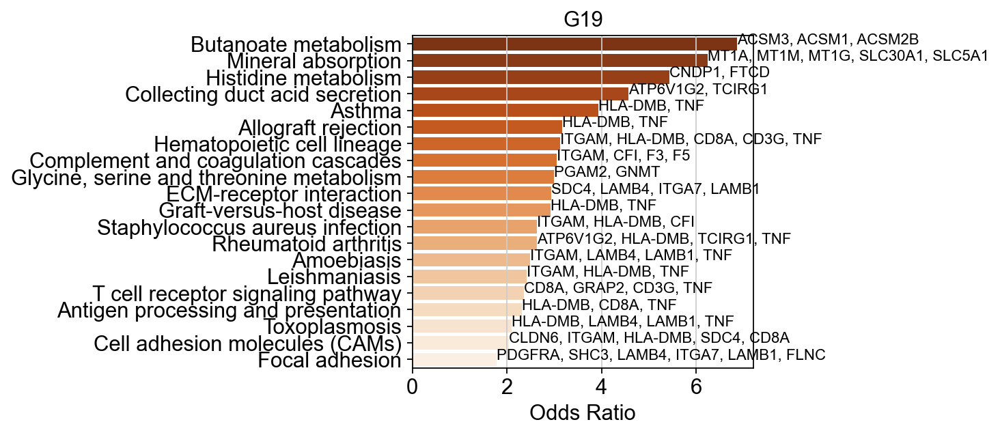

In [22]:
for key in enr_dict_kegg.keys():
    fig,axs = pl.subplots()
    sns.barplot(data=enr_dict_kegg[key].head(20).sort_values(by='Odds Ratio', ascending=False),
                y='Term', x='Odds Ratio', orient='horizontal', palette='Oranges_r', ax=axs)

    i=0
    for index, row in enr_dict_kegg[key].head(20).sort_values(by='Odds Ratio', ascending=False).iterrows():
        axs.text(row['Odds Ratio'], i, row.Genes.replace(';', ', '), color='black', ha="left", fontsize=10)
        i+=1
    pl.ylabel('')
    pl.title(f'G{key}')
    pl.tight_layout()

### Save Supplementary Table 3

In [27]:
df = pd.DataFrame(index=df_gene_set.columns, columns=['gene set', 'genes', 'top 20 GO Biological Process 2018 terms', 'top 20 KEGG_2019_Human pathways'])

In [31]:
for i in df_gene_set.columns:
    df.loc[i, 'gene set'] = f'G{i}'
    df.loc[i, 'genes'] = df_gene_set[i].dropna().tolist()
    df.loc[i, 'top 20 GO Biological Process 2018 terms'] = enr_dict_go[str(i)].head(20).sort_values(by='Odds Ratio', ascending=False)['Term'].tolist()
    df.loc[i, 'top 20 KEGG_2019_Human pathways'] = enr_dict_kegg[str(i)].head(20).sort_values(by='Odds Ratio', ascending=False)['Term'].tolist()

In [33]:
df.to_excel('./Supplementary_table_3.xlsx')

### Scores

In [418]:
for i in range(1,len(np.unique(clusters))+1):
    sc.settings.verbosity=0
    genes = adata_beta_hvg.var_names[clusters==i].tolist()
    sc.tl.score_genes(adata_beta_2, gene_list=genes, score_name=f'G{i}')

In [419]:
gene_sets_all = pd.read_excel('./output_files/gene_sets_beta.xlsx')

for i in gene_sets_all.columns:
    sc.settings.verbosity=0
    genes = gene_sets_all[i].dropna().tolist()
    sc.tl.score_genes(adata_beta_2, gene_list=genes, score_name=f'G{i}')

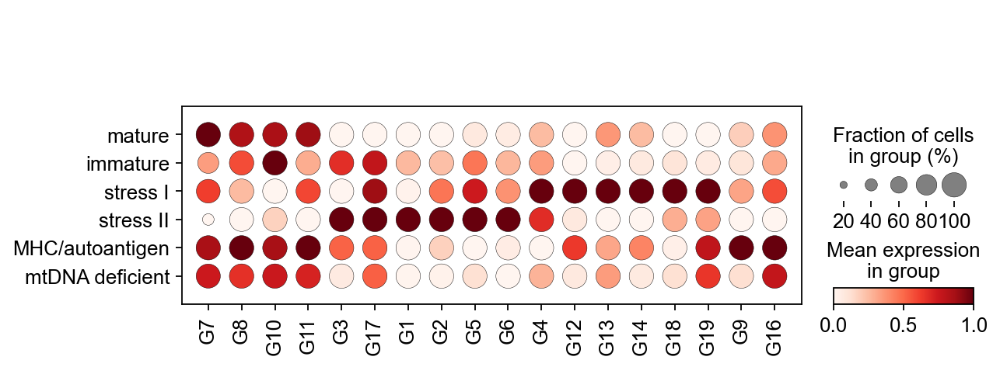

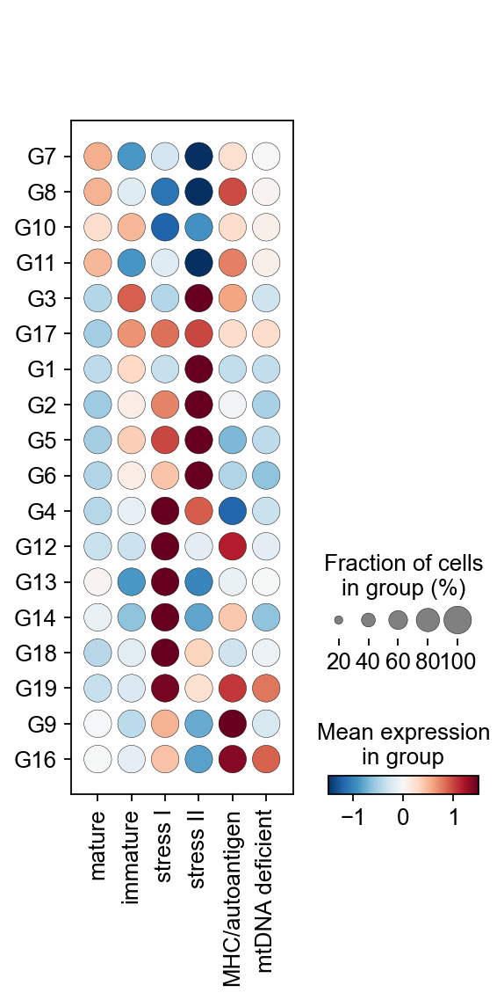

In [487]:
obs_g = ['G7', 'G8', 'G10', 'G11', 'G3', 'G17','G1', 'G2', 'G5', 'G6',  'G4', 'G12', 'G13', 'G14', 'G18', 'G19', 'G9', 'G16']
adata_beta_g = sc.AnnData(adata_beta_2.obs[obs_g])

adata_beta_g.obs = adata_beta.obs
sc.pl.dotplot(adata_beta_g, groupby='louvain_anno_fine', var_names=adata_beta_g.var_names, standard_scale='var', dot_max=1, expression_cutoff=-0.5)
sc.pl.dotplot(sc.pp.scale(adata_beta_g, copy=True), groupby='louvain_anno_fine', var_names=adata_beta_g.var_names, swap_axes=True,  expression_cutoff=-3, vmax=1.5, vmin=-1.5, cmap='RdBu_r')

In [41]:
# markers
gene_sets_all = pd.read_excel('./output_files/gene_sets_beta.xlsx')
gene_sets_marker = {}
for col in gene_sets_all.columns:
    gene_sets_marker[col] = [gene for gene in ['INS','MAFA', 'MAFB', 'PDX1', 'NEUROD1', 'NKX6-1', 'NKX2-2', 'ISL1', 
                                               'MNX1', 'RFX6', 'TSHZ1', 'PAX6', 'FOXO1', 'FOXA2', 'WNT4', 'UCN3',
                                               'CHGA', 'CHGB', 'RBP4', 'CD81', 'HLA-A', 'HLA-B', 'CTSD', 'FOSB', 
                                               'JUND', 'ATF4','IRE1', 'ERN1', 'ATF6', 'DDIT3', 'XBP1', 'PER2', 'CRY1'] if gene in gene_sets_all[col].tolist()]

In [430]:
gene_sets_marker

{1: ['ERN1'],
 2: ['ATF4', 'DDIT3'],
 3: [],
 4: ['JUND'],
 5: [],
 6: [],
 7: [],
 8: ['MAFB', 'NEUROD1', 'NKX2-2', 'ISL1'],
 9: ['RBP4', 'HLA-A', 'HLA-B', 'CTSD'],
 10: [],
 11: ['MAFA'],
 12: ['INS', 'CHGA', 'CHGB', 'FOSB'],
 13: [],
 14: [],
 15: [],
 16: ['NKX6-1', 'UCN3'],
 17: [],
 18: ['PER2', 'CRY1'],
 19: []}

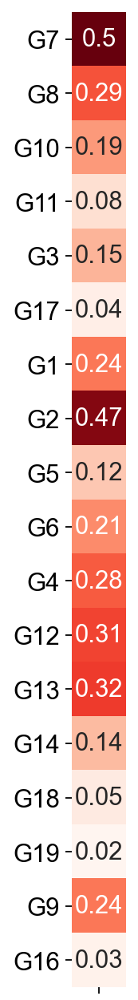

In [318]:
# variance
fig, ax = pl.subplots(figsize=(4,10))
sns.heatmap(pd.DataFrame(np.round(np.std(adata_beta_g.obs[obs_g]),2)), square=True, annot=True, ax=ax, cbar=None, cmap='Reds')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0);
ax.set_xticklabels([''], rotation=0);

## Comparison to T1D islets

### Manifold and clustering

data downloaded from GEO

In [505]:
adata_t1d = sc.read('./data/GSE121863_UMICounts.txt.gz')

... reading from cache file cache/Users-stritschler-Documents-ICB-2020_10X_specied_comparison-human_islets-data-GSE121863_UMICounts.h5ad


In [506]:
adata_t1d = adata_t1d.T

In [507]:
adata_t1d.obs['cond'] = [a.split('_')[1] for a in adata_t1d.obs_names]

In [508]:
sc.pp.filter_genes(adata_t1d, min_cells=10)
sc.pp.normalize_total(adata_t1d, exclude_highly_expressed=True)
sc.pp.log1p(adata_t1d)

filtered out 1192 genes that are detected in less than 10 cells
normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['INS-IGF2', 'CLPS', 'REG3A', 'PNLIP', 'REG1A', 'REG1B', 'CPB1', 'CELA2A', 'MT2A', 'CTRB2', 'CTRB1', 'INS', 'MTRNR2L1', 'CXCL8', 'AMY2A', 'CCL4', 'SST', 'MALAT1', 'NEAT1', 'CELA3A', 'CPA1', 'TTR', 'GCG', 'SPINK1', 'HSPA1A', 'PPY', 'PRSS1', 'FTH1']
    finished (0:00:00)


In [509]:
sc.pp.highly_variable_genes(adata_t1d, n_top_genes=2000)
sc.pp.pca(adata_t1d)
sc.pp.neighbors(adata_t1d)
sc.tl.umap(adata_t1d)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/numba/np/ufunc/parallel.py:355: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 11000. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished (0:00:03)
computing UMAP
    finished (0:00:06)


In [510]:
sc.tl.louvain(adata_t1d, resolution=0.5)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)


... storing 'cond' as categorical


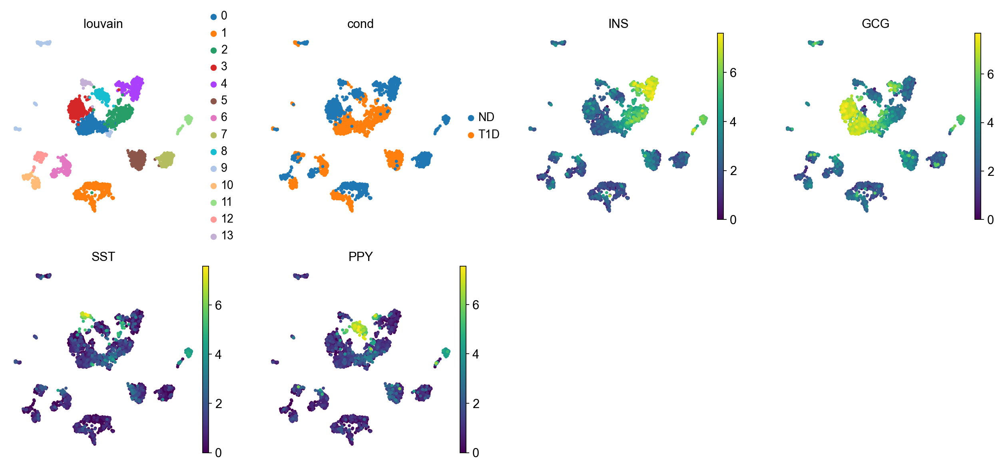

In [511]:
sc.pl.umap(adata_t1d, color=['louvain','cond', 'INS', 'GCG', 'SST', 'PPY'])

In [512]:
adata_t1d = adata_t1d[adata_t1d.obs.louvain.isin(['0', '2', '4', '3', '13', '8'])].copy()
sc.pp.highly_variable_genes(adata_t1d, n_top_genes=2000)
sc.pp.pca(adata_t1d)
sc.pp.neighbors(adata_t1d)
sc.tl.umap(adata_t1d)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
computing UMAP
    finished (0:00:02)


In [513]:
sc.tl.louvain(adata_t1d)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)


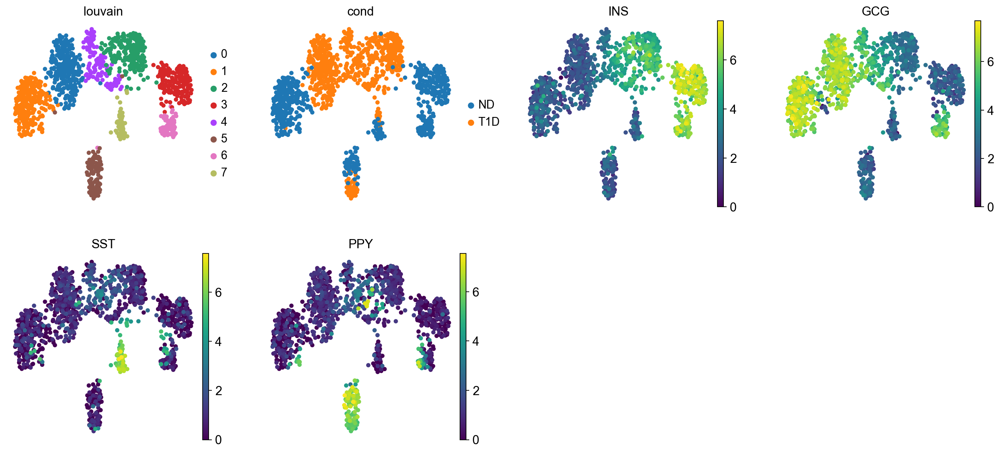

In [514]:
sc.pl.umap(adata_t1d, color=['louvain','cond', 'INS', 'GCG', 'SST', 'PPY'])

In [515]:
map_names = {}
for c in adata_t1d.obs['louvain'].cat.categories:
    if c in ['2', '3']:
        map_names[c] = 'beta'
    elif c in ['1', '0']:
        map_names[c] = 'alpha'
    elif c in ['7']:
        map_names[c] = 'delta'
    elif c in ['6', '4']:
        map_names[c] = 'poly'
    elif c in ['5']:
        map_names[c] = 'PP'

adata_t1d.obs['louvain_anno_broad']=adata_t1d.obs['louvain']
adata_t1d.obs['louvain_anno_broad']=adata_t1d.obs['louvain_anno_broad'].map(map_names).astype('category')

In [516]:
adata_t1d.obs['louvain_anno_broad_cond'] = ['_'.join([a,b]) for a,b in zip(adata_t1d.obs.cond, adata_t1d.obs.louvain_anno_broad)]

In [111]:
adata_t1d.obs['donor'] = [x.rsplit('_',1)[0] for x in adata_t1d.obs.index]

In [112]:
pd.crosstab(adata_t1d.obs['donor'], adata_t1d.obs['louvain_anno_broad'])

louvain_anno_broad,PP,alpha,beta,delta,poly
donor,,,,,
h17181_ND,59,268,175,30,63
h6414_T1D,45,285,211,21,117


In [517]:
adata_t1d_beta = adata_t1d[adata_t1d.obs.louvain.isin(['2', '3'])].copy()

sc.pp.filter_genes(adata_t1d_beta, min_cells=30)

filtered out 6285 genes that are detected in less than 30 cells


In [518]:
sc.pp.neighbors(adata_t1d_beta)
sc.tl.umap(adata_t1d_beta)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
computing UMAP
    finished (0:00:01)


... storing 'louvain_anno_broad_cond' as categorical


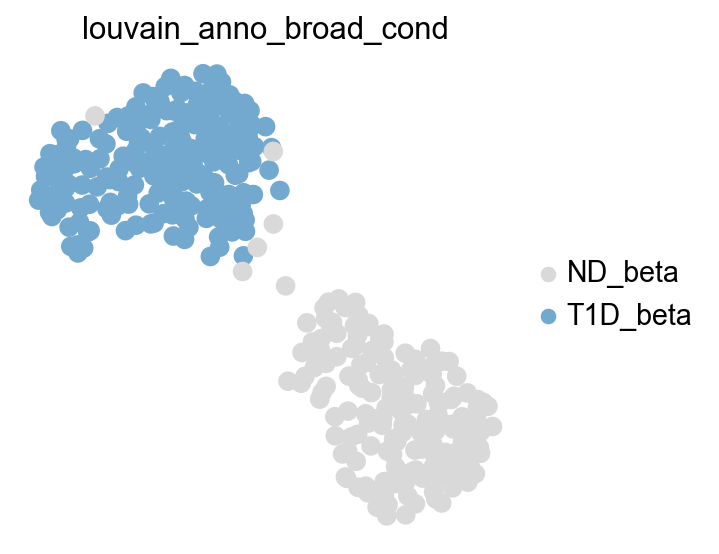

In [519]:
sc.pl.umap(adata_t1d_beta, color=['louvain_anno_broad_cond'], vmin=0, palette=['#d9d9d9', '#74a9cf'])

### Marker expression

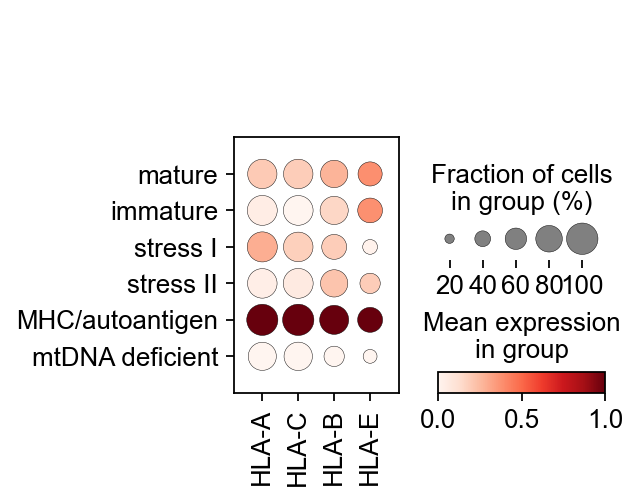

In [48]:
sc.pl.dotplot(adata_beta, var_names=['HLA-A', 'HLA-C', 'HLA-B', 'HLA-E'], groupby='louvain_anno_fine', standard_scale='var')

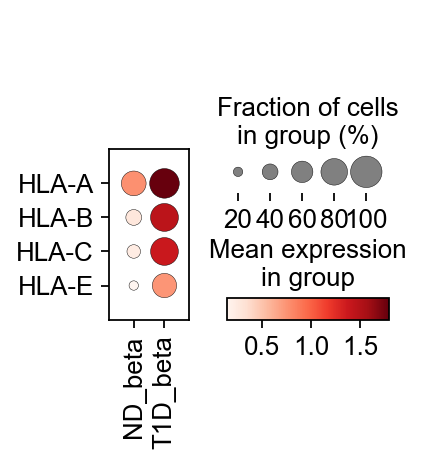

In [592]:
sc.pl.dotplot(adata_t1d_beta, var_names=['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E'], groupby='louvain_anno_broad_cond', swap_axes=True)

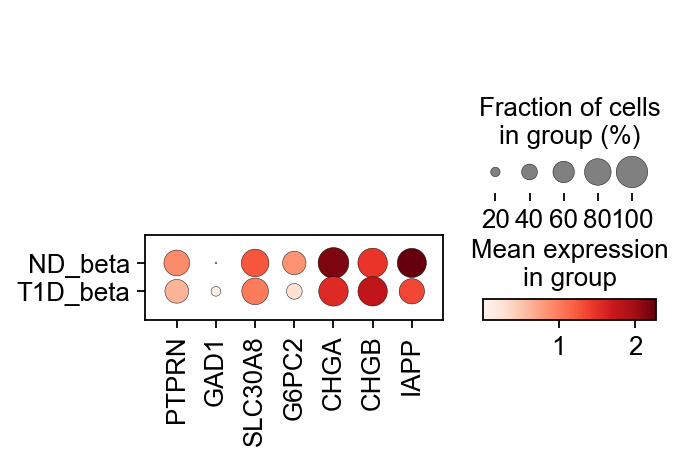

In [588]:
autoantigen = ['PTPRN', 'GAD1', 'SLC30A8', 'G6PC2', 'CHGA', 'CHGB', 'IAPP']
sc.pl.dotplot(adata_t1d_beta, groupby='louvain_anno_broad_cond', 
              var_names=autoantigen)

### T1D beta cell score

ranking genes
    finished (0:00:00)


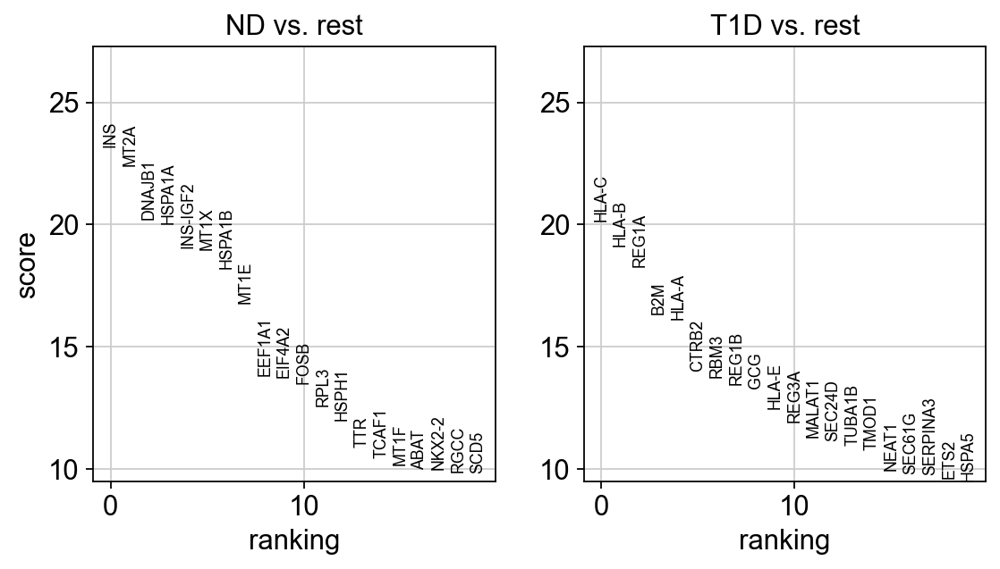

In [50]:
sc.tl.rank_genes_groups(adata_t1d_beta, groupby='cond', method='t-test', n_genes=adata_t1d_beta.n_vars)
sc.pl.rank_genes_groups(adata_t1d_beta)

In [308]:
sc.tl.score_genes(adata_beta, 
                  gene_list=[gene for gene in sc.get.rank_genes_groups_df(adata_t1d_beta, group='T1D')['names'].tolist()[0:50] if gene in adata_beta.var_names], 
                  score_name='t1d_score')
sc.tl.score_genes(adata_beta, 
                  gene_list=[gene for gene in sc.get.rank_genes_groups_df(adata_t1d_beta, group='ND')['names'].tolist()[0:50] if gene in adata_beta.var_names], 
                  score_name='nd_score')

computing score 't1d_score'
    finished (0:00:00)
computing score 'nd_score'
    finished (0:00:00)


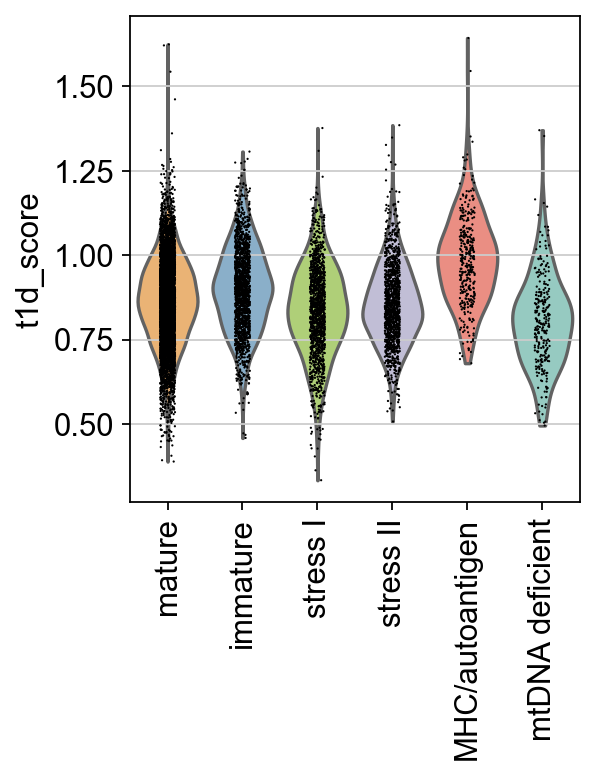

In [310]:
sc.pl.violin(adata_beta, groupby='louvain_anno_fine', keys=['t1d_score'], rotation=90)

In [555]:
for i in range(1,len(np.unique(clusters))+1):
    sc.settings.verbosity=0
    genes = adata_beta_hvg.var_names[clusters==i].tolist()
    genes_t1d = [gene for gene in genes if gene in adata_t1d.var_names]
    
    if len(genes_t1d)/len(genes)>0.5:
        sc.tl.score_genes(adata_t1d_beta, gene_list=genes_t1d, score_name=f'G{i}')

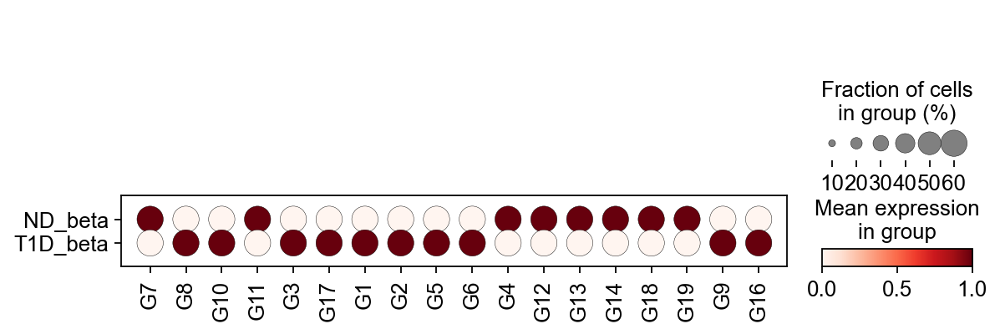

In [556]:
adata_t1d_beta_g = sc.AnnData(adata_t1d_beta.obs[obs_g])
adata_t1d_beta_g.obs = adata_t1d_beta.obs
sc.pl.dotplot(adata_t1d_beta_g, groupby='louvain_anno_broad_cond', var_names=adata_t1d_beta_g.var_names, dot_max=0.6, expression_cutoff=-1, standard_scale='var')

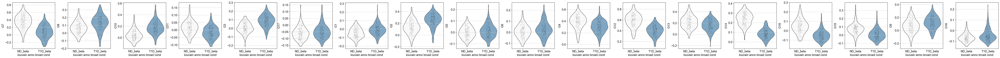

In [559]:
sc.pl.violin(adata_t1d_beta, groupby='louvain_anno_broad_cond', keys=obs_g, palette = ['#f9f9f9', '#74a9cf'])

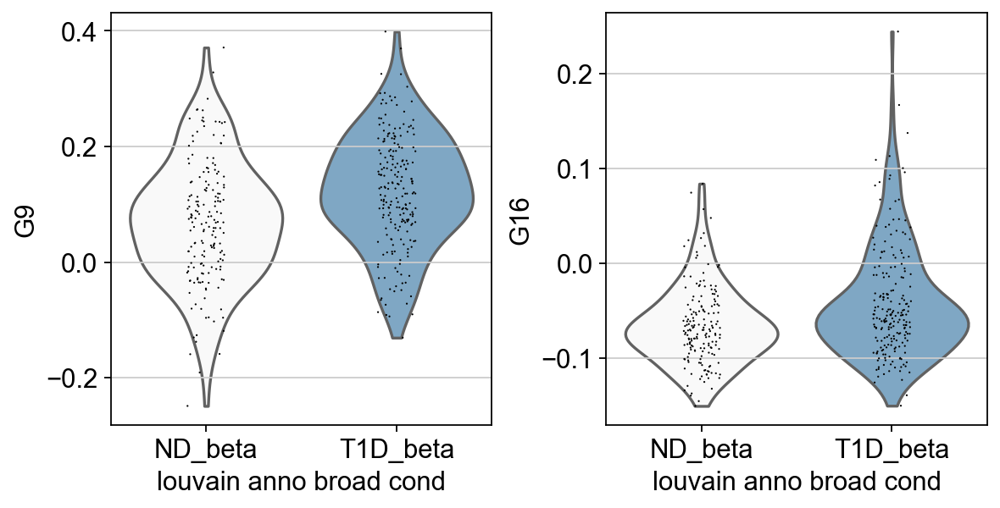

In [564]:
sc.pl.violin(adata_t1d_beta, groupby='louvain_anno_broad_cond', keys=['G9', 'G16'], palette = ['#f9f9f9', '#74a9cf'])

## Comparison to fetal beta cells

### Cao 2020

data curated in curate_fetal_Cao_2020.ipynb

In [42]:
cao_fetal = sc.read('./data/cao_fetal_endo.h5ad')

In [43]:
sc.pp.filter_genes(cao_fetal, min_cells=10)

In [44]:
cao_fetal.obs.louvain_anno_broad.value_counts()

beta               1575
alpha               662
delta               607
epsilon             106
alpha precursos      94
Fev+ precursor       53
beta precursor       37
Name: louvain_anno_broad, dtype: int64

In [45]:
cao_fetal.obs.louvain_anno_broad.cat.rename_categories(['Fev+ precursor', 'alpha', 'alpha precursor', 'beta', 'beta precursor', 'delta', 'epsilon'], inplace=True)
cao_fetal.obs.louvain_anno_broad.cat.reorder_categories(['Fev+ precursor',  'beta precursor', 'beta', 'alpha precursor', 'alpha', 'delta', 'epsilon'], inplace=True)

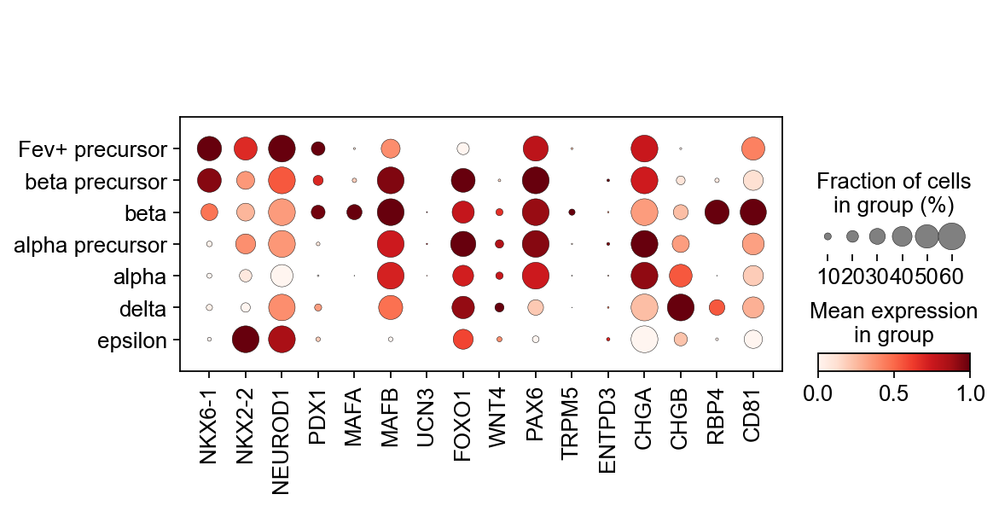

In [46]:
sc.pl.dotplot(cao_fetal, groupby='louvain_anno_broad',
                 var_names=['NKX6-1', 'NKX2-2', 'NEUROD1', 'PDX1', 'MAFA', 'MAFB',   'UCN3', 'FOXO1', 'WNT4', 
                            'PAX6', 'TRPM5', 'ENTPD3', 'CHGA', 'CHGB', 'RBP4', 'CD81'],dot_max=0.6,
                 standard_scale='var')

In [51]:
# subset to beta cell lineage
cao_beta = cao_fetal[cao_fetal.obs.louvain_anno_broad.isin(['beta', 'Fev+ precursor', 'beta precursor'])].copy()

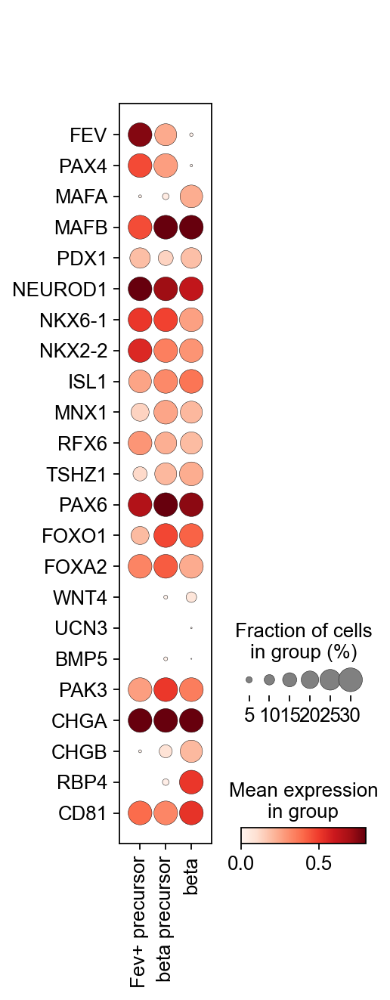

In [184]:
# beta cell function and identity markers
sc.pl.dotplot(cao_beta, groupby='louvain_anno_broad',
                 var_names=['FEV', 'PAX4', 'MAFA', 'MAFB', 'PDX1', 'NEUROD1', 'NKX6-1', 'NKX2-2', 'ISL1', 'MNX1', 'RFX6', 
                            'TSHZ1', 'PAX6', 'FOXO1', 'FOXA2', 'WNT4', 'UCN3', 'BMP5', 'PAK3',
                            'CHGA', 'CHGB', 'RBP4', 'CD81'],dot_max=0.3, vmax=0.8, swap_axes=True)

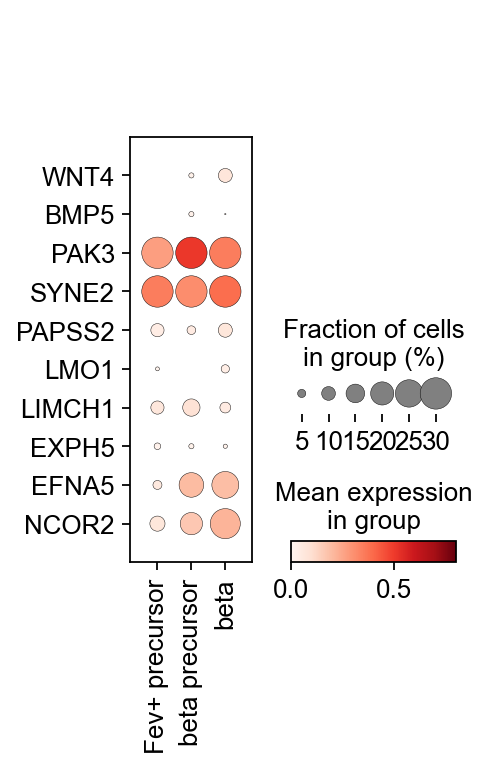

In [190]:
sc.pl.dotplot(cao_beta, groupby='louvain_anno_broad',dot_max=0.3, vmax=0.8, swap_axes=True,
              var_names=[gene for gene in ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'] if gene in cao_beta.var_names])

### Yu 2021

data curated in curate_fetal_Yu_2021.ipynb

In [3]:
yu_fetal = sc.read('./data/yu_endo.h5ad')

In [4]:
mk_human = pd.read_excel('../human_islets_notebooks/data/output_files/gene_sets_beta.xlsx')

In [9]:
# map gene set scores
for i in mk_human.columns:
    sc.settings.verbosity=0
    genes = mk_human[i].dropna().tolist()
    genes_yu = [gene for gene in genes if gene in yu_fetal.var_names]
    if len(genes_yu)/len(genes)>0.4:
        sc.tl.score_genes(yu_fetal, gene_list=genes_yu, score_name=f'G{i}')

In [28]:
yu_beta

AnnData object with n_obs × n_vars = 3774 × 21945
    obs: 'timepoint', 'batch', 'FACS', 'louvain', 'louvain_anno_broad', 'louvain_r', 'louvain_anno', 'G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10', 'G11', 'G12', 'G13', 'G14', 'G15', 'G16', 'G17', 'G18', 'G19'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'hvg', 'louvain', 'louvain_anno_broad_colors', 'louvain_anno_colors', 'neighbors', 'pca', 'timepoint_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [20]:
# subset to beta cell lineage
yu_beta = yu_fetal[yu_fetal.obs.louvain_anno.isin(['Ngn3+ EP', 'beta precursor', 'beta'])].copy()

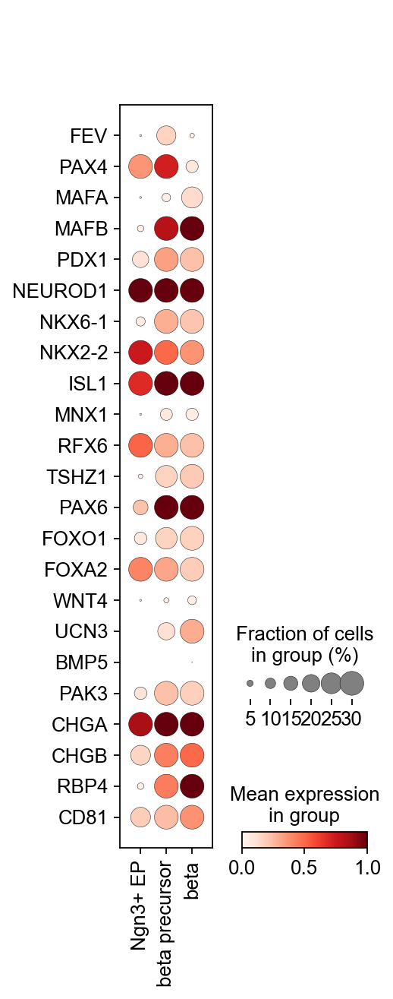

In [30]:
# beta cell function and identity markers
sc.pl.dotplot(yu_beta, groupby='louvain_anno',
                 var_names=['FEV', 'PAX4', 'MAFA', 'MAFB', 'PDX1', 'NEUROD1', 'NKX6-1', 'NKX2-2', 'ISL1', 'MNX1', 'RFX6', 
                            'TSHZ1', 'PAX6', 'FOXO1', 'FOXA2', 'WNT4', 'UCN3', 'BMP5', 'PAK3',
                            'CHGA', 'CHGB', 'RBP4', 'CD81'],dot_max=0.3, vmax=1, swap_axes=True)

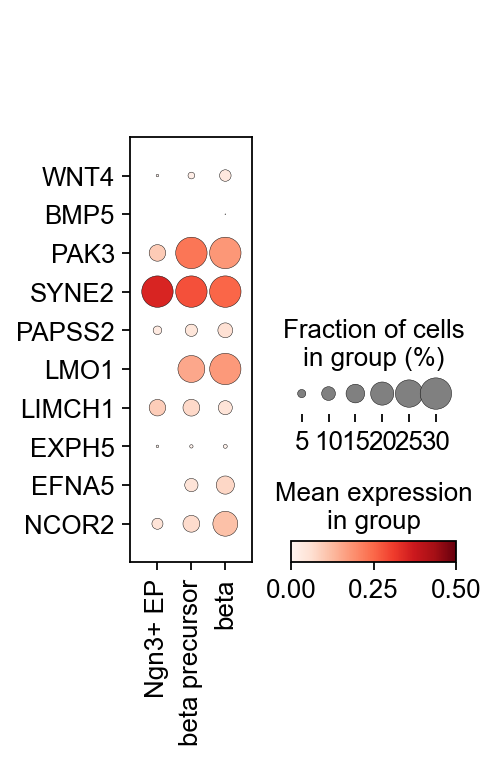

In [35]:
sc.pl.dotplot(yu_beta, groupby='louvain_anno',dot_max=0.3, vmax=0.5, swap_axes=True, 
              var_names=
              [gene for gene in ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'] if gene in yu_beta.var_names])

## Silhouette score alpha vs beta cells

In [36]:
adata_beta = sc.read('./data/adata_human_beta.h5ad')

In [157]:
adata_alpha = sc.read('./data/adata_human_alpha.h5ad')

In [158]:
adata_alpha.obs['louvain_anno_fine'].cat.reorder_categories(['mature', 'immature', 'stress II', 'MHC II'], inplace=True)
adata_alpha.obs['louvain_anno_fine'].cat.rename_categories(['mature', 'immature', 'stress II', 'MHC'], inplace=True)

/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  """Entry point for launching an IPython kernel.
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


In [159]:
import sklearn

In [273]:
s_score_beta = sklearn.metrics.silhouette_score(adata_beta.obsm['X_pca'], adata_beta.obs['louvain_anno_fine'].tolist(), metric='euclidean')

In [274]:
s_score_beta

0.11309781

In [275]:
s_score_alpha = sklearn.metrics.silhouette_score(adata_alpha.obsm['X_pca'], adata_alpha.obs['louvain_anno_fine'].tolist(), metric='euclidean')

In [276]:
s_score_alpha

0.103354454

In [245]:
s_score_beta = sklearn.metrics.silhouette_samples(adata_beta.obsm['X_pca'], adata_beta.obs['louvain_anno_fine'].tolist(), metric='euclidean')

In [247]:
df_beta = pd.DataFrame(s_score_beta, columns=['s_score'])

In [249]:
df_beta['louvain'] = adata_beta.obs['louvain_anno_fine'].tolist()

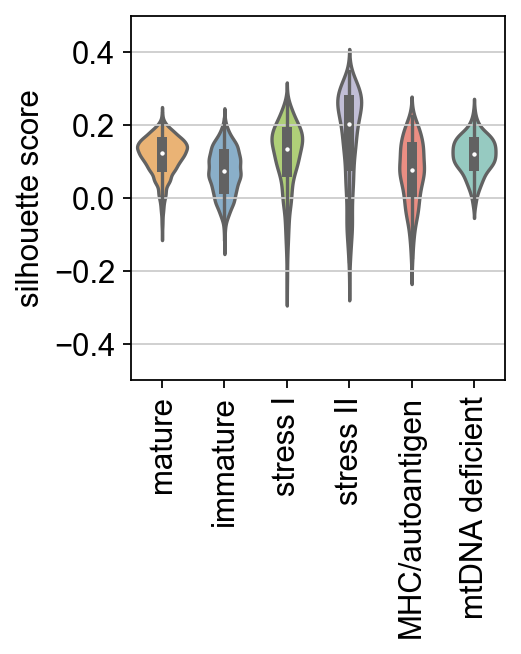

In [287]:
fig, ax = pl.subplots(figsize=(3,3))
sns.violinplot(data=df_beta, x='louvain', y='s_score', ax=ax, order=adata_beta.obs.louvain_anno_fine.cat.categories,
            palette=adata_beta.uns['louvain_anno_fine_colors']);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90);
ax.set_ylabel('silhouette score')
ax.set_xlabel('')
ax.set_ylim([-0.5, 0.5]);

In [259]:
s_score_alpha = sklearn.metrics.silhouette_samples(adata_alpha.obsm['X_pca'], adata_alpha.obs['louvain_anno_fine'].tolist(), metric='euclidean')

In [261]:
df_alpha = pd.DataFrame(s_score_alpha, columns=['s_score'])

In [263]:
df_alpha['louvain'] = adata_alpha.obs['louvain_anno_fine'].tolist()

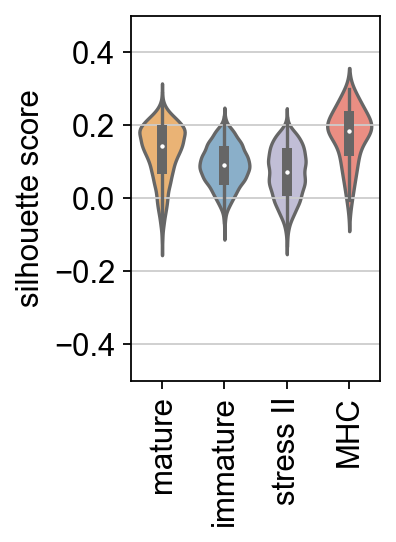

In [289]:
fig, ax = pl.subplots(figsize=(2,3))
sns.violinplot(data=df_alpha, x='louvain', y='s_score', ax=ax, order=adata_alpha.obs.louvain_anno_fine.cat.categories,
            palette=adata_alpha.uns['louvain_anno_fine_colors']);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90);
ax.set_ylabel('silhouette score')
ax.set_xlabel('')
ax.set_ylim([-0.5, 0.5]);